# Project: Philosophy and Wikipedia
**Course 02467: Computational Social Science**  

---

Group 3:
Anders Gjølbye Madsen (s194260), 
Sebastian Ray Mason (s163849),
Jonas Poulsen (s194243).

All members of the group contributed equally to this project.

# 0. Importing Libraries

In [1]:
colab = False
if colab:
    from google.colab import drive
    drive.mount('/content/drive')
    colab_link = "/content/drive/MyDrive/02467/Project/"
else:
    colab_link = ""

import json
import sys
import pandas as pd
import datetime as dt

import nltk
nltk.download('punkt')
nltk.download('stopwords')
from nltk.stem import *
from nltk.stem.snowball import SnowballStemmer
from nltk import word_tokenize
import itertools
import networkx as nx
import numpy as np
import re
import wikipedia
import operator
import ast
import seaborn as sns
import pageviewapi.period 

from datetime import datetime
from pandas import DataFrame
from tqdm.notebook import tqdm
from tqdm import tqdm, tqdm_notebook
import collections
from collections import defaultdict
from matplotlib import pyplot as plt
import matplotlib.dates as mdates

import netwulf as nw
from netwulf import visualize
import networkx as nx

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Jonas\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Jonas\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


# 1. Motivation
The central idea is to use NLP to better understand how philosophers are connected in a social context. Preliminary studies investigate the wikipedia pages for a list of influential philosophers. In so much, the investigation acts as a social network graph across philosophical ideas, core areas and more. We downloaded the dataset several different wikipidia-api's based on which was best suited for the particular task. It is interesting since philosophy has shaped many cultural academic norms, and continues to be relevant for artificial intelligence and big data.

The initial data is gathered using the Python wrapper for Wikipedia’s API, Wikipedia-API 0.5.4. Using the API, first every hyperlink in the four lists of philosophers provided on the Wikipedia page "Lists of philosophers" on Wikipedia under the subsection "Lists of philosophers by name" [https://en.wikipedia.org/wiki/Lists_of_philosophers] was extracted and then used for gathering data for each English Wikipedia page corresponding to these hyperlinks. Intially, the following variables were scraped for each Wikipedia page (if possible); title of the page, content (text), URL (to keep origin) and links (outgoing Wikipedia hyperlinks). All of these variables are in string format.

We chose the particular dataset because Wikipedia is a an Encyclopedia that is used by countless people and scholars to quickly gain insight on various subjects. Furthermore, the Wikipedia structure makes the API's very efficiently such that the networking, mathematics and programming endevors is readily available. We also chose this subject due to personal interest.

The goal for the end user experience is to provide a brief overview of philosophy and its philosophical core-areas. We wish to make the experience interactive and interesting, and perhaps even something we will use ourselves while studying philosophy in our spare time.

The following shows how we have done the above described in practice and created our inital dataset. 

#### Download using wikipediaapi
```python
import wikipedia
import pandas as pd
from tqdm import tqdm
import json

phil_lists = ["List_of_philosophers_(A–C)", "List_of_philosophers_(D–H)", "List_of_philosophers_(I–Q)", "List_of_philosophers_(R–Z)"]

Philosophers = []
for lists in phil_lists:
    Philosophers += wikipedia.page(lists).links

Philosophers = list(set(Philosophers))
cleaned_Philosophers = []
bad_words = ["Index", "ISBN", "List", "Encyclopedia"]

for phil in Philosophers:
    bad = False
    for word in bad_words:
        if word in phil:
            bad = True
    if not bad:
        cleaned_Philosophers += [phil]
        
with open('test.txt', 'w') as f:
    f.write(json.dumps(cleaned_Philosophers))

print("Number of philosophers: ", len(cleaned_Philosophers))

categories = ["Title", "Url", "Links", "Content"]
df = pd.DataFrame(columns=categories)
lost_philosphers = []

#%% 
import wikipediaapi
wiki_wiki = wikipediaapi.Wikipedia('en')

wiki_wiki_lost = []

for philosopher in tqdm(cleaned_Philosophers):
    try:
        curr_page = wiki_wiki.page(philosopher)
        df = df.append({"Title": curr_page.title, "Url": curr_page.fullurl, 
                        "Links": curr_page.links, "Content": curr_page.text}, ignore_index=True)    
    except:
        print("Couldn't find page for following philosopher: ", philosopher)
        wiki_wiki_lost += [philosopher]

df.to_csv("WikiPhilosophers.csv")
```

## 1.1 Gatherring additional attributes
By using ```wptools```, we can gather all the infoboxes, if they are there, and by using that, easily get facts like day of birth or death, where they lived, which schools they went to, regions and so on. This data is a bit easier to handle, that using the already gathered text. 
```python
!pip install wptools
import wptools
tqdm.pandas()
def get_infobox(wiki_site):
    wiki_data = wptools.page(wiki_site).get_parse()
    return wiki_data.data['infobox']

phil_data['Name'] = phil_data.index
phil_data['Infobox'] = phil_data['Name'].progress_apply(get_infobox)
phil_data.to_csv("WikiPhilosophers_with_infobox.csv")
```

Gathering the infoboxes using the wptools was done as stated in the code above. We will find that many of the philosphers either doesn't have all information as it is meither placed in the infobox or it isn't written in the *Template:Infobox_person* format [https://en.wikipedia.org/wiki/Template:Infobox_person], which we will use as our main reference for handling this information. To compensate for missing data, we use birth_years provided by Sune Lehman that he provided for his lectures back in 2017; [https://raw.githubusercontent.com/suneman/socialgraphs2017/master/files/philosopher_birth_year.json].

```python
def get_birthyear(infobox):
    try:
        bd = infobox['birth_date'].lower()
        if ('birth date' or 'bda' or 'birth-date') in bd:
            bd = bd.split('|')
            bd = [re.sub("\D", "", number) for number in bd]
            numbers = list(map(int, list(filter(None, bd))))
            return float(numbers[0])
        
        elif 'birth year' in bd:
            bd = bd.split('|')
            bd = [re.sub("\D", "", number) for number in bd]
            numbers = list(map(int, list(filter(None, bd))))
            return float(numbers[0])
        elif 'century' in bd or 'bc' in bd:
            return np.nan
        else:
            for i in range(4, 0, -1):
                matches = re.findall('-[0-9]{%i}' % i, bd)
                if len(matches) > 0:
                    return float(matches[0])

            for i in range(4, 0, -1):
                matches = re.findall('[0-9]{%i}' % i, bd)
                if len(matches) > 0:
                    return float(matches[0])

            return np.nan
    except:
        return np.nan
```
After having applied above, only a few philosophers are left without a ´birth_year´, and we can therefore simply add the missing ones by finding it manually on the corresponding Wikipedia page.

[Hvodan tilføjede du sunes anders?]

As we see above, around half of the philosophers has the information 'birth date' stated in the infobox (correctly regard the template). However we still find it usable for analysis. 

We see in the above histogram that a large part of the philosopher are from the 19'th century, resulting in a very sqewed histogram...

Similar to above, we find some more attributes which are useful for analysis.

# 2. Basic Stats
The dataset now has the structure as seen bellow, where every row is an observation consisting of a philospher while the collumns have the attributes. 

## 2.1 Cleaning and preprocessing 
Besides the removal of certain pages done in the downloading section (removing all pages which has `["Index", "ISBN", "List", "Encyclopedia"]` in the title), we manually removed 6 pages from the dataset as we manually added the last birth years. The manually removed pages was:
- The Oxford Companion to Philosophy
- Timaeus of Locri
- Glossary of philosophy
- The Cambridge Dictionary of Philosophy
- Floruit
- Outline of philosophy

To prepare for NLP, we prepocess our text by tokenizing the content of each philosopher page. Further preprocessing is described in section 3.2.
```python
phil_data['Content_tokens'] = phil_data['Content'].apply(word_tokenize)

```

### 2.1.1 Finding associated philosophers (cleaning links)
As our objective is to map out branches of philosophers based on their connections and core-areas, we want to add a list to each philosopher consisting of the philsophers they are associated with. Here, we make the assumption that if a philosopher has a hyperlink (the `Links` attribute) to another philosopher, then two philosophers are associated with each other in the sence that the philosopher named in the hyperlink is inspiring the philosopher of the current page. [TJEK OP PÅ DET HER] 

The format of the hyperlinks is a strich which follows a dictionary like structure;
`"{'Bencao Gangmu': Bencao Gangmu (id: ??, ns: 0), 'Buddhist': Buddhist (id: ??, ns: 0), 'Cantonese': Cantonese (id: ??, ns: 0)"`, 
and therfore, if we make a spille at every `("'")` and only use every second word, we gent the following cleaned links:
`['Bencao Gangmu', 'Buddhist', 'Cantonese']`
wherin the title of associated philosophers wil be. Therefore we made following function which we apply to the `Links` column:

```python
def clean_links(link):
    return link.split("'")[1::2]
phil_data['Links_clean'] = phil_data['Links'].apply(clean_links)
```

We can then make a list of pairs with the associated philosophers by applying intersection between the philosopher set (set of all philosophers), and the links.

```python
phil_set = phil_data.index
phil_data["Associated_phils"] = (phil_data["Links_clean"].apply(set)).apply(lambda x: x.intersection(phil_set))
```

### 2.1.2 Core-areas
As we want to work with modularity and how we can seperate our network, we have `wikipedia` library to scrape the core area lists from the Wikipedia website. Notice that further into the analysis, we will infer the missing core-area by interpretting this information through the connections in the graph, however this is described in the analysis.

```python
aestheticians = wikipedia.page("List_of_aestheticians").links
epistemologists = wikipedia.page("List_of_epistemologists").links
ethicists = wikipedia.page("List_of_ethicists").links
logicians = wikipedia.page("List_of_logicians").links
metaphysicians = wikipedia.page("List_of_metaphysicians").links
sociopoliticals = wikipedia.page("index_of_sociopolitical_thinkers").links

#ranked after size (under the assumption that if you are in a small group, that is important)
areas = [sociopoliticals, ethicists, logicians, metaphysicians, epistemologists, aestheticians]
areas_name = ['sociopoliticals','ethicists','logicians','metaphysicians','epistemologists','aestheticians']
```

```python
aestheticians = set(aestheticians)
epistemologists = set(epistemologists)
ethicists = set(ethicists)
logicians = set(logicians)
metaphysicians = set(metaphysicians)
sociopoliticals = set(sociopoliticals)
```

```python
for philosopher in phil_data.index:
    if ('Aesthetics' or 'Aestheticians') in phil_data.loc[philosopher].Links_clean:
        aestheticians.add(philosopher)
    if ('Epistemology' or 'Epistemologists') in phil_data.loc[philosopher].Links_clean:
        epistemologists.add(philosopher)
    if ('Ethics' or 'Ethicist') in phil_data.loc[philosopher].Links_clean:
        ethicists.add(philosopher)
    if ('Logic' or 'Logician') in phil_data.loc[philosopher].Links_clean:
        logicians.add(philosopher)
    if ('Metaphysics' or 'Metaphysicians') in phil_data.loc[philosopher].Links_clean:
        metaphysicians.add(philosopher)
    if ('Sociopolitcs' or 'Sociopoliticals') in phil_data.loc[philosopher].Links_clean:
        sociopoliticals.add(philosopher)
```

```python
areas = []
for phil in phil_data.index:
    add = []
    if phil in aestheticians:
        add += ['aestheticians']
    if phil in epistemologists:
        add += ['epistemologists']
    if phil in ethicists:
        add += ['ethicists']
    if phil in logicians:
        add += ['logicians']
    if phil in metaphysicians:
        add += ['metaphysicians']
    if phil in sociopoliticals:
        add += ['sociopoliticals']
    areas += [add]

phil_data['areas'] = areas
```

### 2.1.3 Page-Views

We also find it relevant to gather the pageview data. This can be done using the ```pageviewapi 0.4.0```. Using this allows us to gather either daily or monthly pageview count for each site for a period of time.

There are several things to consider when collecting pageviews. First and foremost it depends on how we want to use it for our data analysis. Using all-time views can give an unfair advantage considering lifetime for the page' exsistance. Furthermore, the hyperlinks between the pages might have changed over time - and since we collected thes hyperlinks recently, it makes more sense to look at recent pageview-counts.

```python
# We can gather the data in different intervals, periods and so on. [https://pypi.org/project/pageviewapi/]
def get_pageview(philosopher):
    try:
        page_view = pageviewapi.period.sum_last('en.wikipedia', philosopher, 
                                last=30, access='all-access', 
                                agent='all-agents')
    except:
        page_view = None
        print("Didn't work for: ", philosopher )
    return page_view
```

```python
page_views = []
for phil in tqdm(list(phil_data.index)):
    page_views.append(get_pageview(phil))
```

```python
phil_data['View_count'] = page_views
```

### 2.1.4 Loading in the preprocessed dataset
After having performed abovementioned procedures for the dataset, we made a "checkpoint" which is what the rest of the notebook will be based on. By checking whether each column is equal to the one made before saving, we have validated that we are loading it in correctly. 

In [2]:
def string_dict(string):
    try:
        return ast.literal_eval(string)
    except:
        return None
    
def string_set(string):
    try:
        return ast.literal_eval(string)
    except:
        return set([])
    
def string_list(string):
    try:
        return ast.literal_eval(string)
    except:
        return list([])

phil_data = pd.read_csv('WikiPhilosophers_new2.csv', index_col='Title')
phil_data['Infobox'] = phil_data['Infobox'].apply(string_dict)
phil_data['Associated_phils'] = phil_data['Associated_phils'].apply(string_set)
phil_data['Content_tokens'] = phil_data['Content_tokens'].apply(string_list)
phil_data['Links_clean'] = phil_data['Links_clean'].apply(string_list)
phil_data['areas'] = phil_data['areas'].apply(string_list)
phil_data['Year'] = phil_data['Year'].apply(int)

## 2.2 Statistics of the dataset

In [174]:
phil_data.head()

,Url,Links,Content,Infobox,Content_tokens,Links_clean,Associated_phils,Year,areas,View_count
Title,,,,,,,,,,
Liu An,https://en.wikipedia.org/wiki/Liu_An,{'BIBSYS (identifier)': BIBSYS (identifier) (i...,"Liú Ān (Chinese: 劉安, c. 179–122 BC) was a Han ...","{'t': '劉安', 's': '刘安', 'p': 'Liú Ān', 'j': 'La...","[Liú, Ān, (, Chinese, :, 劉安, ,, c., 179–122, B...","[BIBSYS (identifier), BNF (identifier), Bencao...",{Zhu Xi},-179,[],797.0
Charles Babbage,https://en.wikipedia.org/wiki/Charles_Babbage,"{'(ε, δ)-definition of limit': (ε, δ)-definiti...",Charles Babbage (; 26 December 1791 – 18 Octo...,"{'name': 'Charles Babbage', 'image': 'Charles ...","[Charles, Babbage, (, ;, 26, December, 1791, –...","[(ε, δ)-definition of limit, 1851 Great Exhibi...","{Augustus De Morgan, Adam Smith, Hermann von H...",1791,[metaphysicians],53293.0
Louis Gabriel Ambroise de Bonald,https://en.wikipedia.org/wiki/Louis_de_Bonald,{'18th-century philosophy': 18th-century philo...,"Louis Gabriel Ambroise, Vicomte de Bonald (2 O...","{'region': '[[Western philosophy]]', 'era': '[...","[Louis, Gabriel, Ambroise, ,, Vicomte, de, Bon...","[18th-century philosophy, Académie française, ...","{Augustine of Hippo, Socrates, Joseph de Maist...",1754,[],288.0
Ruth Barcan Marcus,https://en.wikipedia.org/wiki/Ruth_Barcan_Marcus,{'Abingdon-on-Thames': Abingdon-on-Thames (id:...,Ruth Barcan Marcus (; born Ruth Charlotte Barc...,"{'region': '[[Western philosophy]]', 'era': '[...","[Ruth, Barcan, Marcus, (, ;, born, Ruth, Charl...","[Abingdon-on-Thames, Alan Ross Anderson, Ameri...","{John Searle, Saul Kripke, Bertrand Russell, C...",1921,[logicians],1077.0
Zeno of Elea,https://en.wikipedia.org/wiki/Zeno_of_Elea,{'Academic skepticism': Academic skepticism (i...,Zeno of Elea (; Greek: Ζήνων ὁ Ἐλεᾱ́της; c. 49...,"{'name': 'Zeno of Elea', 'region': '[[Western ...","[Zeno, of, Elea, (, ;, Greek, :, Ζήνων, ὁ, Ἐλε...","[Academic skepticism, Adrastus of Aphrodisias,...","{Marcus Aurelius, Gregory of Nyssa, Socrates, ...",-495,[metaphysicians],11003.0


### 2.2.1 Basic Statistics of the dataset
Having the preprocessing in place, we can finally have a look at som basic statistics of the dataset. We end up having 1726 observation with 10 variables wich has a total size of 126 MB. We are quite satisfied with the size of the dataset, keeping in mind how specific the subject is.  

In [175]:
print('The dataset has {0} observations and {1} variables.'.format(phil_data.shape[0], phil_data.shape[1]))
print('Variables: ', list(phil_data.columns))

The dataset has 1726 observations and 10 variables.
Variables:  ['Url', 'Links', 'Content', 'Infobox', 'Content_tokens', 'Links_clean', 'Associated_phils', 'Year', 'areas', 'View_count']


### 2.2.2 Birth years
At the end of our analysis, we will use the birth years of each philosopher to get a grasp of how our philosophers are distributed over time. For an initial impression, a histogram is plotted below. Here we find that the data is very skewed, having 50% of the observations after the year 1821. 

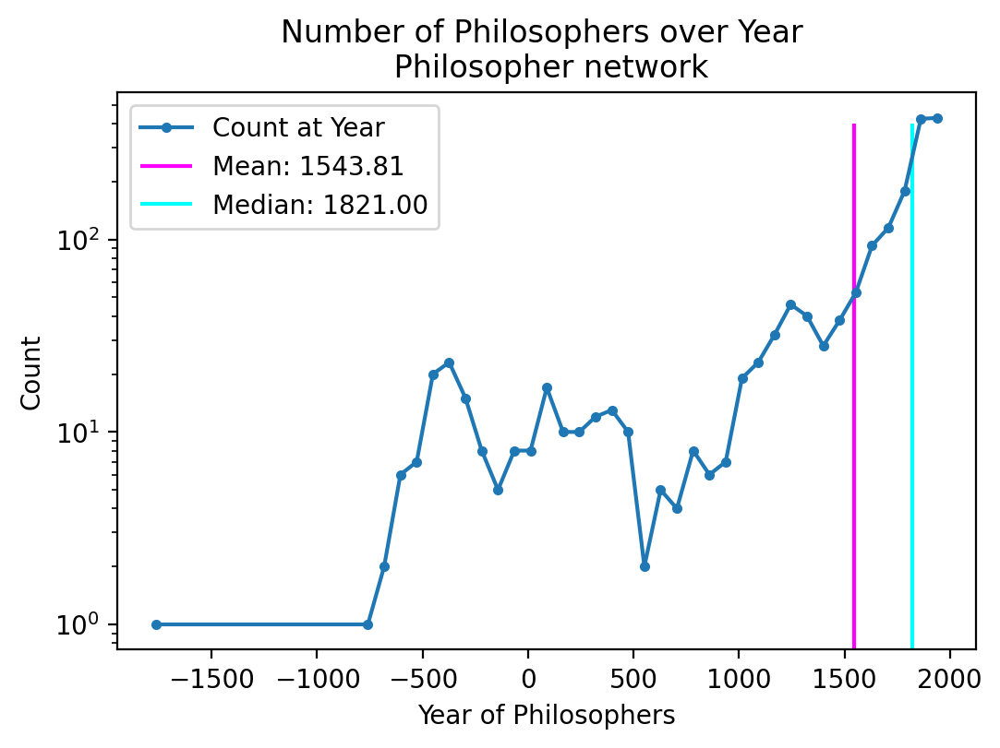

In [4]:
birth_dates = list(phil_data.Year)
bins = np.linspace(min(birth_dates), max(birth_dates), num=50)
hist_in, edges_in = np.histogram(birth_dates, bins=bins, density=False)
x_in = (edges_in[1:]+edges_in[:-1])/2

xx_in, yy_in = zip(*[(i,j) for (i,j) in zip(x_in,hist_in) if j>0])

fig, ax = plt.subplots(1, 1, dpi=200, sharey=True)
#ax.plot(xx_in, yy_in, marker=".", label = 'Density of viewcounts')
ax.plot(xx_in, yy_in, marker=".", label = 'Count at Year')
#ax.vlines(366,0,400, label = 'Big Daddy Kierkegaard', color = 'darkorange')
ax.vlines(np.mean(birth_dates), 0, 400, label = 'Mean: {0:.2f}'.format(np.mean(birth_dates)), color = 'magenta')
ax.vlines(np.median(birth_dates), 0, 400, label = 'Median: {0:.2f}'.format(np.median(birth_dates)), color = 'cyan')
ax.set_xlabel("Year of Philosophers")
ax.set_ylabel("Count")
#ax.set_xscale("log")
ax.set_yscale("log")
ax.set_title('Number of Philosophers over Year \n Philosopher network')
ax.legend();

### 2.2.3 Page-Views

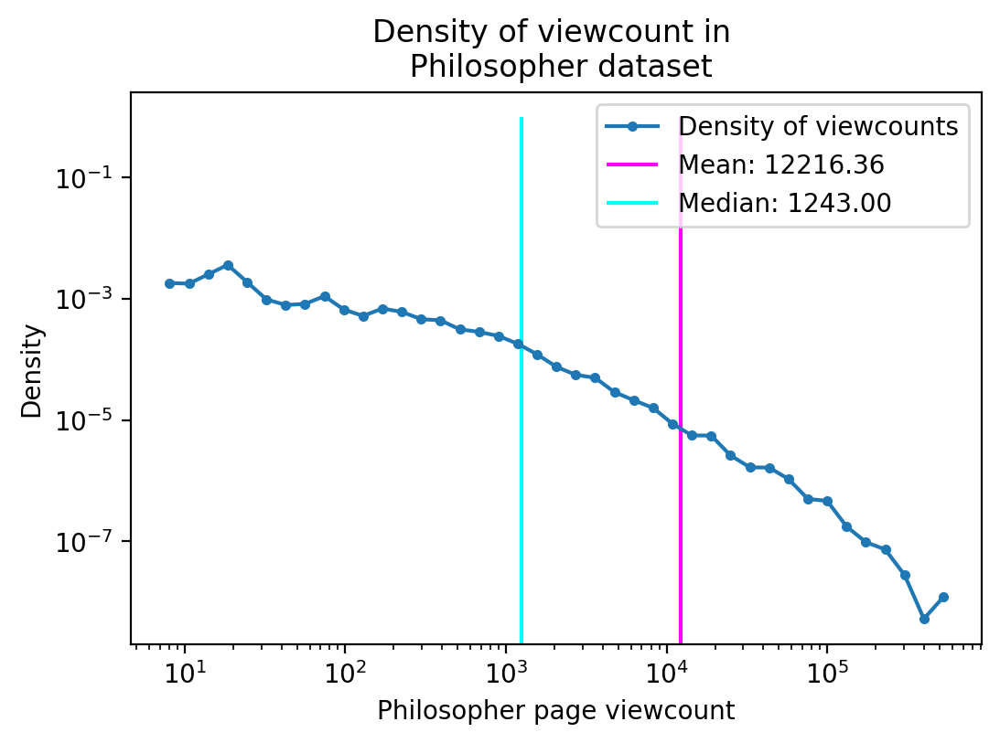

In [5]:
view_counts = phil_data['View_count'].dropna()

bins = np.logspace(0, np.log10(max(view_counts)), num=50)
hist_in, edges_in = np.histogram(view_counts, bins=bins, density=True)
x_in = (edges_in[1:]+edges_in[:-1])/2

xx_in, yy_in = zip(*[(i,j) for (i,j) in zip(x_in,hist_in) if j>0])

fig, ax = plt.subplots(1, 1, dpi=200, sharey=True)
ax.plot(xx_in, yy_in, marker=".", label = 'Density of viewcounts')
ax.vlines(np.mean(view_counts), 0, 1, label = 'Mean: {0:.2f}'.format(np.mean(view_counts)), color = 'magenta')
ax.vlines(np.median(view_counts), 0, 1, label = 'Median: {0:.2f}'.format(np.median(view_counts)), color = 'cyan')
ax.set_xlabel("Philosopher page viewcount")
ax.set_ylabel("Density")
ax.set_xscale("log")
ax.set_yscale("log")
ax.set_title('Density of viewcount in \n Philosopher dataset')
ax.legend();

In [71]:
view_count_network = []

for phil in G_Di.to_undirected().nodes():
    view_count_network += [phil_data.loc[phil]['View_count']]
    G_Di.nodes[phil]["view_count"] = phil_data.loc[phil]['View_count']

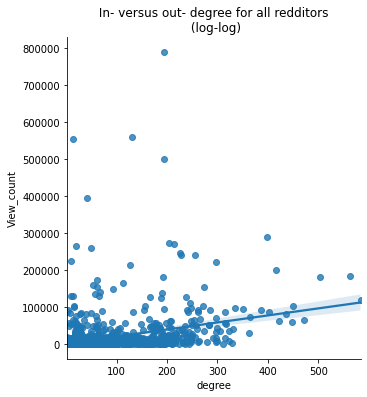

In [72]:
data = DataFrame(list(dict(G_Di.to_undirected().degree()).values()),columns=['degree'])
data = data.assign(View_count=view_count_network)
sns.lmplot(x = 'degree', y = 'View_count', data=data);
plt.title(' In- versus out- degree for all redditors \n (log-log)');

# 3. Tools, theory and analysis

In the following, we will describe which tools and what theory we have used for our analysis and describe this and the analysis in greater detail. Notice that we have restructured this section a bit, as it makes more sense for our dataset to analyse the network at first, then do text analysis, and then return to some final network analysis which ties the two things together. 

## 3.1 The Directed Network
The direction of the network is highly relevant as we use this in our assumption about which philosophers are inspired by who as:
<center>
<i>The outgoing links from a philosopher page represent <br>
    which philosphers has inspired the philosopher</i><br>
</center>

### 3.1.1 Constructing the Directed Network
First, we construct an edge list based the `Associated_phils` column in our dataset:

In [3]:
edge_list_philosopher = []

for title in phil_data.index:    
    for associated in phil_data.loc[title, 'Associated_phils']:
        edge_list_philosopher.append((title, associated))
        
len(edge_list_philosopher)

69109

Next, we can construct the directed network using NetworkX:

In [4]:
G_Di = nx.DiGraph()
G_Di.add_edges_from(edge_list_philosopher)

As we are working with hypelinks which only refers to philosophers in the dataset, we expect the in- and out-degree to be the same. To make sure we made the edges correctly, we do a sanity check:

In [5]:
in_degree = list(dict(G_Di.in_degree()).values())
out_degree = list(dict(G_Di.out_degree()).values())
print("Same amount of in- as out-degree: ", np.sum(in_degree) == np.sum(out_degree))

Same amount of in- as out-degree:  True


### 3.1.2 Initial Network Analysis
In order to comment on the graph structure of the network, we would like to investigate the degree distributions, since we know that real networks are not normally distributed, but rather follow a power-law. 

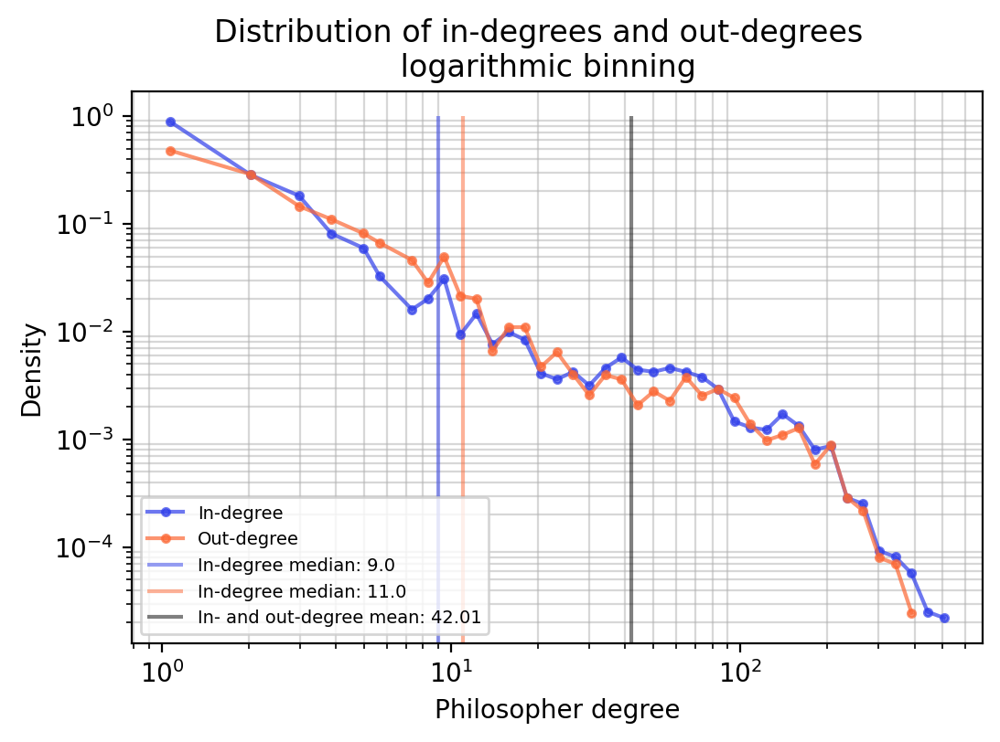

In [6]:
bins = np.logspace(0, np.log10(537), num=50)
hist_in, edges_in = np.histogram(in_degree, bins=bins, density=True)
x_in = (edges_in[1:]+edges_in[:-1])/2
hist_out, edges_out = np.histogram(out_degree, bins=bins, density=True)
x_out = (edges_out[1:]+edges_out[:-1])/2

xx_in, yy_in = zip(*[(i,j) for (i,j) in zip(x_in,hist_in) if j>0])
xx_out, yy_out = zip(*[(i,j) for (i,j) in zip(x_out,hist_out) if j>0])
fig, ax = plt.subplots(1, 1, dpi=200, sharey=True)
ax.plot(xx_in, yy_in, marker=".", color = '#2f3eea',label = 'In-degree',alpha = 0.7)
ax.set_xlabel("Philosopher degree")
ax.set_ylabel("Density")
ax.set_xscale("log")
ax.set_yscale("log")
ax.plot(xx_out, yy_out, marker=".", color = '#fc6734',label = 'Out-degree',alpha = 0.7)
ax.vlines(np.median(list(dict(G_Di.in_degree()).values())), 0, 1, color = '#2f3eea', alpha = 0.5, label = 'In-degree median: '+str(np.median(list(dict(G_Di.in_degree()).values()))))
ax.vlines(np.median(list(dict(G_Di.out_degree()).values())), 0, 1, color = '#fc6734', alpha = 0.5, label = 'In-degree median: '+str(np.median(list(dict(G_Di.out_degree()).values()))))
ax.vlines(np.mean(list(dict(G_Di.out_degree()).values())), 0, 1, color = 'black', alpha = 0.5, label = 'In- and out-degree mean: ' + str(np.mean(list(dict(G_Di.out_degree()).values())).round(2)))
ax.grid(True, which = 'minor', alpha = 0.5)
plt.suptitle('Distribution of in-degrees and out-degrees \n logarithmic binning')
plt.legend(fontsize = 7, loc = 3)
plt.savefig('Directed_phil_dist_dir', dpi = 1000)
plt.plot();

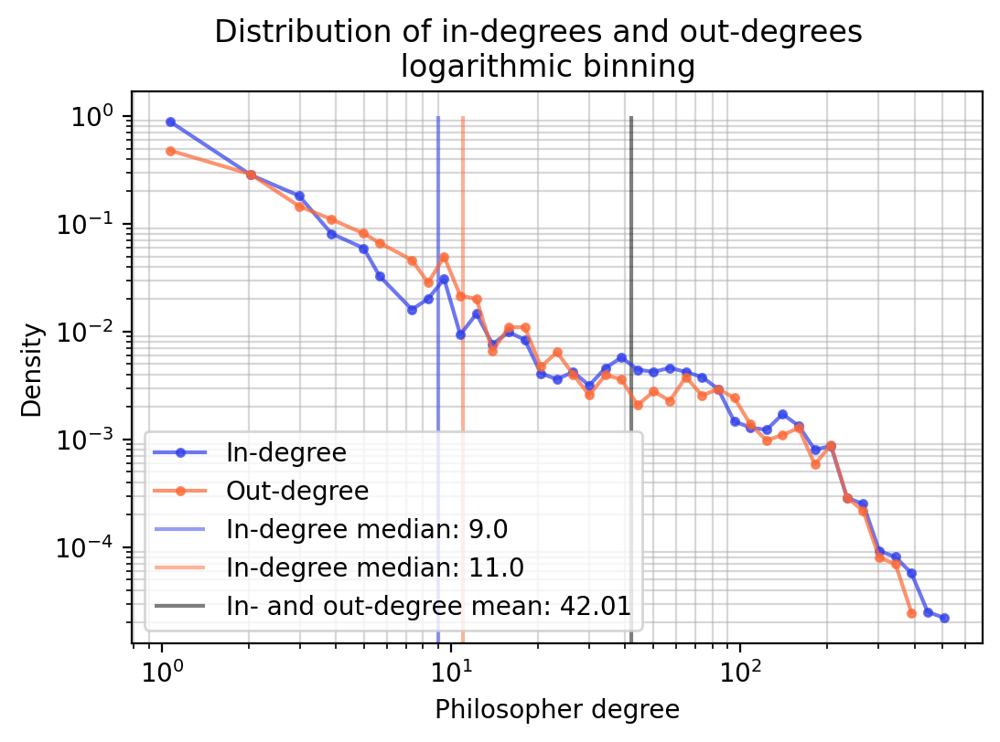

In [7]:
bins = np.logspace(0, np.log10(537), num=50)
hist_in, edges_in = np.histogram(in_degree, bins=bins, density=True)
x_in = (edges_in[1:]+edges_in[:-1])/2
hist_out, edges_out = np.histogram(out_degree, bins=bins, density=True)
x_out = (edges_out[1:]+edges_out[:-1])/2

xx_in, yy_in = zip(*[(i,j) for (i,j) in zip(x_in,hist_in) if j>0])
xx_out, yy_out = zip(*[(i,j) for (i,j) in zip(x_out,hist_out) if j>0])
fig, ax = plt.subplots(1, 1, dpi=200, sharey=True)
ax.plot(xx_in, yy_in, marker=".", color = '#2f3eea',label = 'In-degree',alpha = 0.7)
ax.set_xlabel("Philosopher degree")
ax.set_ylabel("Density")
ax.set_xscale("log")
ax.set_yscale("log")
ax.plot(xx_out, yy_out, marker=".", color = '#fc6734',label = 'Out-degree',alpha = 0.7)
ax.vlines(np.median(list(dict(G_Di.in_degree()).values())), 0, 1, color = '#2f3eea', alpha = 0.5, label = 'In-degree median: '+str(np.median(list(dict(G_Di.in_degree()).values()))))
ax.vlines(np.median(list(dict(G_Di.out_degree()).values())), 0, 1, color = '#fc6734', alpha = 0.5, label = 'In-degree median: '+str(np.median(list(dict(G_Di.out_degree()).values()))))
ax.vlines(np.mean(list(dict(G_Di.out_degree()).values())), 0, 1, color = 'black', alpha = 0.5, label = 'In- and out-degree mean: ' + str(np.mean(list(dict(G_Di.out_degree()).values())).round(2)))

ax.grid(True, which = 'minor', alpha = 0.5)

plt.suptitle('Distribution of in-degrees and out-degrees \n logarithmic binning')
plt.legend(loc = 3)
plt.savefig('Directed_phil_dist', dpi = 1000)
plt.plot();

### 3.1.3 Random Network Analysis
We can then investigate how different the philosophy network is from a random network, to further show the reader and underline that we are working with a network that resembles a real network. 

In [8]:
len(set(phil_data.index) - set(list(G_Di.nodes().keys())).intersection(set(phil_data.index))) == len(phil_data) - len(G_Di.nodes())

True

In [9]:
np.mean(list(dict(G_Di.in_degree()).values()))

42.01155015197568

In [10]:
#making the random network parameters
N = G_Di.number_of_nodes()
L = G_Di.number_of_edges()

p = L/((N*(N-1)))
avg_k = p*(N-1)

print("The value of p is: {:.4}, and the average degree of the philosopher (undirected) network is: {:.4}".format(p,avg_k))

The value of p is: 0.02555, and the average degree of the philosopher (undirected) network is: 42.01


In [11]:
# creating the random network and a sanity check
RN = nx.erdos_renyi_graph(n = N, p = p, seed=69, directed=True)
RN_in_degree = list(dict(RN.in_degree()).values())
RN_out_degree = list(dict(RN.out_degree()).values())
np.sum(in_degree) == np.sum(out_degree)

True

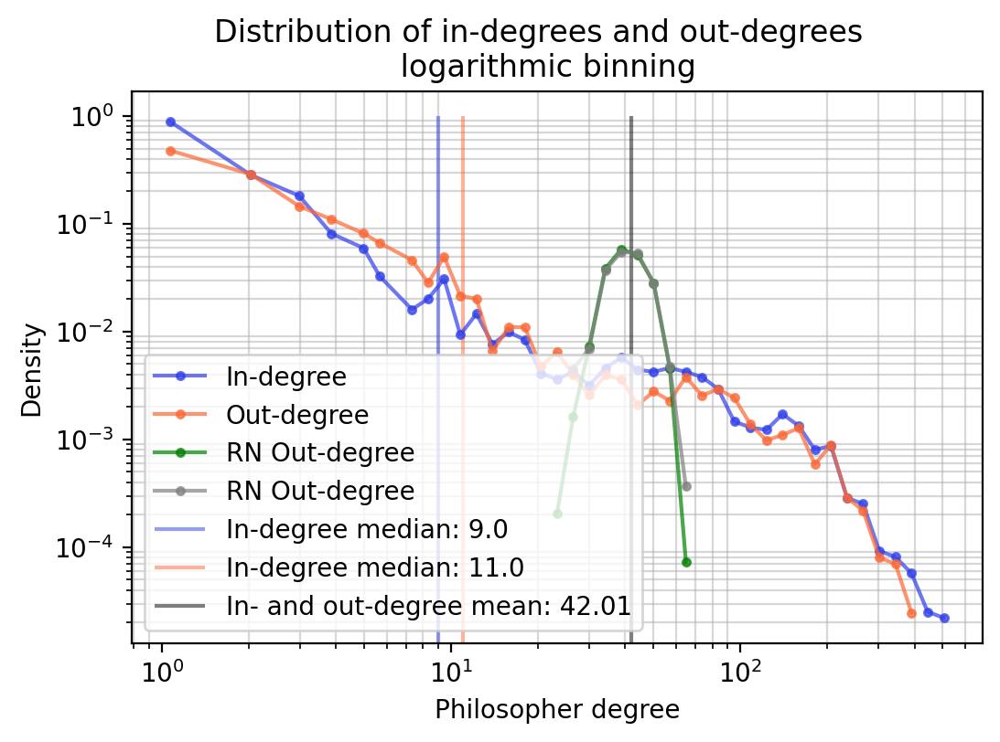

In [12]:
bins = np.logspace(0, np.log10(537), num=50)
hist_in, edges_in = np.histogram(in_degree, bins=bins, density=True)
x_in = (edges_in[1:]+edges_in[:-1])/2
hist_out, edges_out = np.histogram(out_degree, bins=bins, density=True)
x_out = (edges_out[1:]+edges_out[:-1])/2
hist_in_RN, edges_in = np.histogram(RN_in_degree, bins=bins, density=True)
x_in_RN = (edges_in[1:]+edges_in[:-1])/2
hist_out_RN, edges_out = np.histogram(RN_out_degree, bins=bins, density=True)
x_out_RN = (edges_out[1:]+edges_out[:-1])/2

xx_in, yy_in = zip(*[(i,j) for (i,j) in zip(x_in,hist_in) if j>0])
xx_out, yy_out = zip(*[(i,j) for (i,j) in zip(x_out,hist_out) if j>0])
xx_in_RN, yy_in_RN = zip(*[(i,j) for (i,j) in zip(x_in_RN,hist_in_RN) if j>0])
xx_out_RN, yy_out_RN = zip(*[(i,j) for (i,j) in zip(x_out_RN,hist_out_RN) if j>0])


fig, ax = plt.subplots(1, 1, dpi=200, sharey=True)
ax.plot(xx_in, yy_in, marker=".", color = '#2f3eea',label = 'In-degree',alpha = 0.7)
ax.set_xlabel("Philosopher degree")
ax.set_ylabel("Density")
ax.set_xscale("log")
ax.set_yscale("log")
ax.plot(xx_out, yy_out, marker=".", color = '#fc6734',label = 'Out-degree',alpha = 0.7)
ax.plot(xx_in_RN, yy_in_RN, marker=".", color = 'green',label = 'RN Out-degree',alpha = 0.7)
ax.plot(xx_out_RN, yy_out_RN, marker=".", color = 'grey',label = 'RN Out-degree',alpha = 0.7)

ax.vlines(np.median(list(dict(G_Di.in_degree()).values())), 0, 1, color = '#2f3eea', alpha = 0.5, label = 'In-degree median: '+str(np.median(list(dict(G_Di.in_degree()).values()))))
ax.vlines(np.median(list(dict(G_Di.out_degree()).values())), 0, 1, color = '#fc6734', alpha = 0.5, label = 'In-degree median: '+str(np.median(list(dict(G_Di.out_degree()).values()))))
ax.vlines(np.mean(list(dict(G_Di.out_degree()).values())), 0, 1, color = 'black', alpha = 0.5, label = 'In- and out-degree mean: ' + str(np.mean(list(dict(G_Di.out_degree()).values())).round(2)))
ax.grid(True, which = 'minor', alpha = 0.5)
plt.suptitle('Distribution of in-degrees and out-degrees \n logarithmic binning')
plt.legend(loc = 3)
plt.savefig('Directed_phil_dist', dpi = 1000)
plt.plot();

The above graph clearly shows that the philosophy network deviates from the random network created from its parameters, hence we conclude that we are dealing with a network that is different from random.

Below we do another sanity check to see if the largest degree node in the philosophy network is greater than the largest node in the random network. It is.

In [13]:
max(list((dict(G_Di.degree()).values()))) > max([RN.degree()[w] for w in range(len(RN.nodes()))])

True

And the sum of in/and out degrees are also the same. 

In [14]:
print("Average degree of the Reddit network is: {} \nAverage degree of the random network is: {}".format(np.mean(list((dict(G_Di.degree()).values()))), np.mean(list(dict(RN.degree()).values()))))

Average degree of the Reddit network is: 84.02310030395137 
Average degree of the random network is: 83.60729483282675


### 3.1.4 Top in- and out degree
To help the reader understand the connection between the large graph, and the distribution analisys, we present the top in- and out degree nodes in the philosophy network. This does not by definition directly mean that these are the most important, but as we shall see later, when investigating centrality, most of the names re-appear. 

In [19]:
import collections

in_counter = collections.Counter(dict(dict(G_Di.in_degree())))
out_counter = collections.Counter(dict(dict(G_Di.out_degree())))

In [20]:
(in_counter.most_common()[:10],out_counter.most_common()[:10])

([('Aristotle', 535),
  ('Immanuel Kant', 530),
  ('Plato', 438),
  ('Georg Wilhelm Friedrich Hegel', 422),
  ('Thomas Aquinas', 397),
  ('David Hume', 390),
  ('Augustine of Hippo', 384),
  ('Friedrich Nietzsche', 366),
  ('Karl Marx', 362),
  ('Bertrand Russell', 358)],
 [('Plato', 379),
  ('Immanuel Kant', 370),
  ('Baruch Spinoza', 348),
  ('Georg Wilhelm Friedrich Hegel', 346),
  ('Augustine of Hippo', 338),
  ('Friedrich Nietzsche', 331),
  ('David Hume', 329),
  ('Bertrand Russell', 314),
  ('Aristotle', 309),
  ('Gottfried Leibniz', 296)])

As seen, the most referenced philosophers in the network (denoted by the in-degree) are well-known.

### 3.1.5 Scatterplot
Next, the reader might notice that some of the same philosophers appear in both top in- and out degree nodes. And thus we continue the analisys with a brief scatterplot of top in- and out degree, and also compute the correlation. 

C:\Users\Jonas\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in log10
  


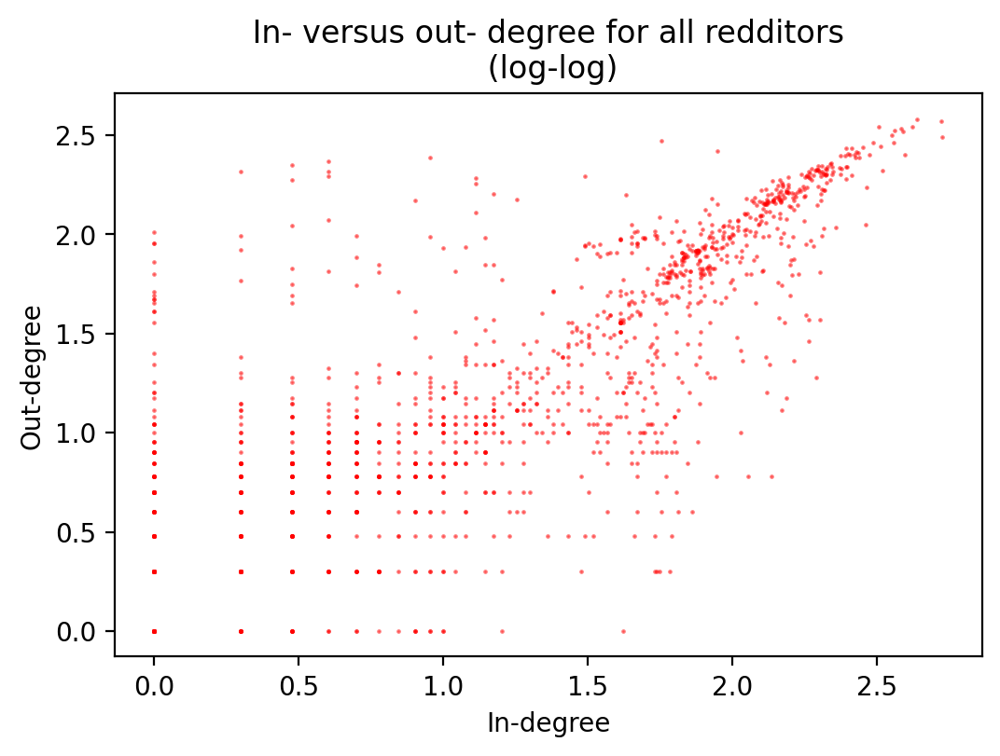

In [15]:
fig, ax = plt.subplots(dpi=200)
ax.scatter(np.log10(in_degree), np.log10(out_degree), marker=".", s=2, alpha=0.5, color="red")
plt.title(' In- versus out- degree for all redditors \n (log-log)')
plt.ylabel('Out-degree')
plt.xlabel('In-degree');

In [129]:
np.corrcoef(in_degree,out_degree)

array([[1.        , 0.84692286],
       [0.84692286, 1.        ]])

As seen, the in- and out-degrees are correlated, meaning that one typically says something about the other. We wish to present this finding for the reader in an intuitive way, and thus provide the following plot:

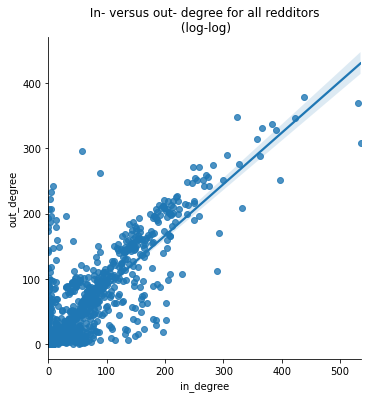

In [16]:
data = DataFrame(in_degree,columns=['in_degree'])
data = data.assign(out_degree=out_degree)
sns.lmplot(x = 'in_degree', y = 'out_degree', data=data);
plt.title(' In- versus out- degree for all redditors \n (log-log)');

### 3.1.5 Core-area assignment
The next step is to assign core-areas to the philosophers. This is perhaps the most ambitious (and assumptious) part of the assignment, as we basically infer the core area of philosophers based on their neighbours in the network. We shall not comment on why this is not necessarily the best way of doing this now, but will comment on it in the discussion. It should be noted that the node attribute 'areas' means the core-area assigned. 

First, we make a node attribute 'area' for each node in the network. And set this equal to none for all nodes. 

In [17]:
for nodes in list(G_Di.nodes()):
    G_Di.nodes[nodes]["areas"] = None

Next, we iterate over unambigious nodes, meaning those philosophers which only have one areas from the branch list introduced earlier. We also print the names of philosophers whom are not in the graph. It should be noted, that we actually take the first 'areas' entry from the dataframe and assign this, which means that ambigious philosophers will have a core-area for a brief moment, which will then be corrected.

In [18]:
len(phil_data.loc['Charles Babbage'].areas)

1

In [19]:
# making unambigious nodes. 
for philosopher in phil_data.index:
    if len(phil_data.loc[philosopher].areas) > 0:
        try: 
            G_Di.nodes[philosopher]["areas"] = phil_data.loc[philosopher].areas[0]
        except:
            print('following philosopher was not present in the graph: ' + str(philosopher))
        

following philosopher was not present in the graph: Evander Bradley McGilvary
following philosopher was not present in the graph: Edmund Gurney
following philosopher was not present in the graph: R.R. Rockingham Gill
following philosopher was not present in the graph: Virgil Aldrich
following philosopher was not present in the graph: Lynne Rudder Baker
following philosopher was not present in the graph: Akos Pauler
following philosopher was not present in the graph: Paul Horwich
following philosopher was not present in the graph: Malcolm Budd
following philosopher was not present in the graph: Miura Baien
following philosopher was not present in the graph: Alexander Gerard
following philosopher was not present in the graph: Zeami Motokiyo
following philosopher was not present in the graph: Richard Brinkley


We then make a copy of the current state of the graph, which we will use for lookup purposes when assigning ambigious nodes (those philosopher which appear in multiple branches of philosophy). 

G_Di_Lookup = G_Di.copy()

The next part is a bit tricky, first we check if a given philosopher has more areas than one. If they do, then we check the neighbours for that node (philosopher) in the graph and count how many neighbours are already assigned to one of those branches. We then let the highest count determine the core-area of the philosopher in the graph. 

By doing this, we make sure that philosophers such as Ludwigg Wittgenstain who appears in only two of the branches, can only be assigned to those two branches, even though he might have more neighbours in other branches of philosophy. In doing this we prioritize the structure branches of philosophy provided by Wikipedia. 

In [20]:
# assign ambigious nodes to area of most neighbors

G_Di_Lookup = G_Di.copy()

for philosopher in phil_data.index:
    if len(phil_data.loc[philosopher].areas) > 1:
        
        counter_areas = dict((key, 0) for key in phil_data.loc[philosopher].areas)
        try: 
            for neighbor in list(G_Di_Lookup[philosopher]):
                for area in list(phil_data.loc[neighbor].areas):
                    counter_areas[area] += 1
                    
            G_Di.nodes[philosopher]["areas"] = max(counter_areas.items(), key=operator.itemgetter(1))[0]
        except: 
            pass
        
            
                

Finally, for nodes that have no area (meaning they do not show up in any branches of philosophy from Wikipedia) we simply do a majority count based on core area in the graph and assign the largest areas as the core area in the graph. 

In [21]:
# for nodes with no area
# making unambigious nodes. 
# We now look at G_Di 
empty_philosophers = []
for philosopher in list(G_Di.nodes()):
    if not phil_data.loc[philosopher].areas:
        empty_philosophers += [philosopher]

for philosopher in tqdm(empty_philosophers):   
    counter_areas = dict([('sociopoliticals',0),
                          ('ethicists',0),
                          ('logicians',0),
                          ('metaphysicians',0),
                          ('epistemologists',0),
                          ('aestheticians',0)]) 

    for neighbor in list(G_Di[philosopher]):
        if G_Di.nodes[neighbor]["areas"] == 0:
                for area in list(G_Di.nodes[neighbor]["areas"]):
                    counter_areas[area] += 1


        if max(counter_areas.items(), key=operator.itemgetter(1))[0] == None:
            G_Di.remove(philosophers)
        G_Di.nodes[philosopher]["areas"] = max(counter_areas.items(), key=operator.itemgetter(1))[0]
    
          

100%|█████████████████████████████████████████████████████████████████████████████| 807/807 [00:00<00:00, 13714.04it/s]


Finally we assign each node a color, and remove nodes that have not been assigned any attribute 'areas', meaning core-area.

In [22]:
remove_node = []
for node in G_Di.nodes():
    if G_Di.nodes[node]["areas"] == "sociopoliticals": G_Di.nodes[node]['color'] = "#F6D04D"
    elif G_Di.nodes[node]["areas"] == "ethicists": G_Di.nodes[node]['color'] = "#2F3EEA"
    elif G_Di.nodes[node]["areas"] == "logicians": G_Di.nodes[node]['color'] = "#030F4F"
    elif G_Di.nodes[node]["areas"] == "metaphysicians": G_Di.nodes[node]['color'] = "#1FD082"
    elif G_Di.nodes[node]["areas"] == "epistemologists": G_Di.nodes[node]['color'] = "#FC7634"
    elif G_Di.nodes[node]["areas"] == "aestheticians": G_Di.nodes[node]['color'] = "#E83F48"
    else:
        print('Gonna remove ' + str(node))
        remove_node += node
        
G_Di.remove_nodes_from(remove_node)

Gonna remove Ibn Masarra
Gonna remove Seiichi Hatano
Gonna remove Stanisław Ignacy Witkiewicz
Gonna remove Friedrich Meinecke
Gonna remove Marko Marulić
Gonna remove Genevieve Lloyd
Gonna remove Michael Frede
Gonna remove Abraham Cohen de Herrera
Gonna remove John Sergeant (priest)
Gonna remove Michael Ruse
Gonna remove C. Lloyd Morgan
Gonna remove René Le Senne
Gonna remove Antonio Aliotta
Gonna remove Aron Gurwitsch
Gonna remove Dariush Shayegan
Gonna remove Woo Tsin-hang
Gonna remove John Balguy
Gonna remove José Martí
Gonna remove Lorraine Code
Gonna remove Vatsyayana
Gonna remove Rudi Supek
Gonna remove Syed Zafarul Hasan
Gonna remove Ibn Kammuna
Gonna remove Hermann Graf Keyserling


And let the the 'core_area' be defined in the phil_data dataframe. Some philosophers still do not have any 'core-area' and will be given a None type core-area instead. 

In [23]:
phil_data['Core_area'] = None
for phil in phil_data.index:
    try: 
        phil_data.loc[phil, 'Core_area'] = G_Di.nodes[phil]["areas"]
    except: 
        phil_data.loc[phil, 'Core_area'] = None

TypeError: 'NoneType' object is not subscriptable

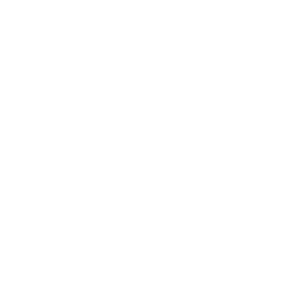

In [14]:

config_G_area = {'zoom': 0.7,
                 'node_charge': -80,
                 'node_gravity': 0.04,
                 'link_distance': 0.1,
                 'link_distance_variation': 1,
                 'node_collision': True,
                 'wiggle_nodes': True,
                 'freeze_nodes': False,
                 'node_fill_color': '#79aaa0',
                 'node_stroke_color': '#555555',
                 'node_label_color': '#000000',
                 'display_node_labels': False,
                 'scale_node_size_by_strength': True,
                 'node_size': 20,
                 'node_stroke_width': 0.95,
                 'node_size_variation': 0.4,
                 'link_color': '#7c7c7c',
                 'link_width': 0.2,
                 'link_alpha': 0.25,
                 'link_width_variation': 0.5,
                 'display_singleton_nodes': True,
                 'min_link_weight_percentile': 0,
                 'max_link_weight_percentile': 1}

network, config = visualize(G_Di, verbose=False, config=config_G_area);

fig, ax = nw.draw_netwulf(network)
plt.show()

#nw.add_node_label(ax, network, 'Aristotle', dy=15)
#nw.add_node_label(ax, network, 'Immanuel Kant', dy=15)
#nw.add_node_label(ax, network, 'Plato', dy=15)
#nw.add_node_label(ax, network, 'Karl Marx', dy=15)

### 3.1.6 Exporting as JSON to D3.js

In [84]:
graph = {'nodes' : [],
         'links' : []}

for title in phil_data.index:
    graph['nodes'].append({'id': title,
                           'start': phil_data.loc[title, 'Year']})
    
    for associated in phil_data.loc[title, 'Associated_phils']:
        if phil_data.loc[title, 'Year'] >= phil_data.loc[associated, 'Year']:
            graph['links'].append({'source': title,
                   'target' : associated,
                   'start' : phil_data.loc[title, 'Year']+1})
        else:
            graph['links'].append({'source': associated,
                   'target' : title,
                   'start' : phil_data.loc[associated, 'Year']+1})
"""            
for title in phil_data.index:
    graph['nodes'].append({'id': title,
                           'start': phil_data.loc[title, 'Year']})
    
    for associated in phil_data.loc[title, 'Associated_phils']:
        graph['links'].append({'source': title,
                   'target' : associated,
                   'start' : min(phil_data.loc[title, 'Year'], phil_data.loc[associated, 'Year'])})
"""

"            \nfor title in phil_data.index:\n    graph['nodes'].append({'id': title,\n                           'start': phil_data.loc[title, 'Year']})\n    \n    for associated in phil_data.loc[title, 'Associated_phils']:\n        graph['links'].append({'source': title,\n                   'target' : associated,\n                   'start' : min(phil_data.loc[title, 'Year'], phil_data.loc[associated, 'Year'])})\n"

## 3.2 Text Analysis
Having all the philosophers splitted into different core-areas, allows us to perform a more interesting text analysis as we have an reasonable overview of the documents (as we don't have to look through all 1726 philosophers), and we can analyse wheither the spilts seems reasonable taking our expectations regard the contet of the documents into account.

To perform natural language processing of the data, we want to clean out the content tokens that we created earlier. We go through the following steps:
- **Step 1:** Removing punctuation as well as setting all letters to lowercase using regex and pythons `.lower()`. The explaination of the regex query is that we want to match the following:
    - `\w+` for match one or more word caracters ([a-zA-Z0-9])
    - `|` either
    - `\S\w` None-whitespace word caracters
- **Step 2:** Remove all the english stopwords (as we only use english wikipedia pages) 
- **Step 3:** Remove all numbers. 
- **Step 4:** Remove "'s" as this doesn't disapear in the above operations
- **Step 5:** Remove every philosopher-name based on the names in each observations.

First we list all our philosophernames:

In [24]:
phil_names = list(phil_data.index)
phil_names = [w.split() for w in phil_names]
phil_names = [item.lower() for sublist in phil_names for item in sublist]

And the create our `remove_rubbish` function: 

In [25]:
stopwords = nltk.corpus.stopwords.words('english')
def remove_rubbish(tokens):
    step1 = [w.lower() for w in tokens if re.search(r'\w+|\S\w', w)] # remove punctuation if in beginning, and set to lower.
    step2 = [w for w in step1 if w not in stopwords] # Remove stopwords
    step3 = [w for w in step2 if re.search(r'^(?!\d).*$', w)] # remove numbers.
    step4 = [w for w in step3 if w != "'s"] # Remove 's
    tokens = [w for w in step4 if w not in phil_names]
    return tokens

In [26]:
phil_data['Content_tokens']

Title
Liu An                              [Liú, Ān, (, Chinese, :, 劉安, ,, c., 179–122, B...
Charles Babbage                     [Charles, Babbage, (, ;, 26, December, 1791, –...
Louis Gabriel Ambroise de Bonald    [Louis, Gabriel, Ambroise, ,, Vicomte, de, Bon...
Ruth Barcan Marcus                  [Ruth, Barcan, Marcus, (, ;, born, Ruth, Charl...
Zeno of Elea                        [Zeno, of, Elea, (, ;, Greek, :, Ζήνων, ὁ, Ἐλε...
                                                          ...                        
Otto Weininger                      [Otto, Weininger, (, German, :, [, ˈvaɪnɪŋɐ, ]...
Nachman Krochmal                    [Nachman, HaKohen, Krochmal, (, Hebrew, :, נחמ...
Samuel Johnson (pamphleteer)        [Samuel, Johnson, (, 1649–1703, ), was, an, En...
Kao Tzu                             [Gaozi, (, Chinese, :, 告子, ;, pinyin, :, Gàozǐ...
Émile Saisset                       [Émile, Edmond, Saisset, (, 16, September, 181...
Name: Content_tokens, Length: 1726, dtype: objec

We have experimented with some stemming for this project where we originally used ehe 'english' SnowballStemmer as this is better according to [ https://www.nltk.org/howto/stem.html ]. However, after seing those results, we found it more reasonable to keep the words unstemmed. Moreover, for the sentiment analysis, it is prefered not to stem the corpus [ https://journals.plos.org/plosone/article?id=10.1371/journal.pone.0026752 ]. 
```python
stemmer = SnowballStemmer("english")
def stemmer(tokens):
    singles = [SnowballStemmer("english").stem(token) for token in tokens]
    return singles
```

In [27]:
tqdm.pandas()
phil_data['Content_tokens_clean'] = phil_data['Content_tokens'].progress_apply(remove_rubbish)
phil_data['Content_tokens_clean']

100%|██████████████████████████████████████████████████████████████████████████████| 1726/1726 [02:20<00:00, 12.29it/s]


Title
Liu An                              [liú, ān, chinese, 劉安, bc, dynasty, chinese, p...
Charles Babbage                     [december, october, english, polymath, mathema...
Louis Gabriel Ambroise de Bonald    [vicomte, october, november, french, counter-r...
Ruth Barcan Marcus                  [born, charlotte, february, american, academic...
Zeno of Elea                        [greek, ζήνων, ὁ, ἐλεᾱ́της, bc, pre-socratic, ...
                                                          ...                        
Otto Weininger                      [german, ˈvaɪnɪŋɐ, april, october, austrian, t...
Nachman Krochmal                    [hakohen, hebrew, נחמן, קְרוֹכְמַל‎, born, bro...
Samuel Johnson (pamphleteer)        [english, clergyman, political, writer, someti...
Kao Tzu                             [gaozi, chinese, 告子, pinyin, gàozǐ, wade–giles...
Émile Saisset                       [edmond, september, december, french, philosop...
Name: Content_tokens_clean, Length: 1726, dtype:

### 3.2.1 Making text documents for each core-area
By using our assigned core-areas for each philosopher from the network analysis, we are now able to use every philosopher to analyse the text within each core-area. We make a dictionary consisting of all the tokens with each of the 6 core-areas (each area is a key): 

In [28]:
areas_name = ['sociopoliticals','ethicists','logicians','metaphysicians','epistemologists','aestheticians']
area_documents = {}
for area in areas_name:
    area_documents[area] = ([item for sublist in phil_data['Content_tokens_clean'][phil_data['Core_area'] == area] for item in sublist])

### 3.2.2 Term-frequency
Let's take a look at the most frequent words. At first we used the following definition of term-frequency [ https://en.wikipedia.org/wiki/Tf%E2%80%93idf ]: 
$$
\mathrm{tf}(t, d)=\frac{f_{t, d}}{\sum_{t^{\prime} \in d} f_{t^{\prime}, d}}
$$
 wherein $f_{t, d}$ is the raw count of the term _t_ in document _d_, and $\sum_{t^{\prime} \in d} f_{t^{\prime}, d}$ denotes the raw count of all other terms except _t_ in the document. However, as we moved further into our analysis, and started experimenting the wordclouds based on TF-IDF, we found it useful to just use the raw count given as:
$$
\mathrm{tf}(t, d)=f_{t, d}
$$
In the following we create a function which takes an entire document as a variable, and returns a dictionary containing all unique terms and their respective frequencies. If the second input "top" is added, it returns the n'th most frequent words in the document. This is used to get an overview of the most frequent words in each document (either content of one particular philosopher or larger documents i.e. branches of philosophy). 

In [362]:
def TF(document, top = None):
    fd = dict(nltk.FreqDist(document))
    if top:
        fd = nltk.FreqDist(document).most_common(top)
    return fd

In [363]:
for phil in phil_data.index:
    print("{0:<33}: {1}".format(phil, TF(phil_data.Content_tokens_clean[phil] , 5))) # GME

Liu An                           : [('chinese', 9), ('huainan', 9), ('dynasty', 8), ('bean', 8), ('curd', 8)]
Charles Babbage                  : [('engine', 43), ('difference', 24), ('science', 24), ('also', 24), ('london', 23)]
Louis Gabriel Ambroise de Bonald : [('sur', 8), ('pp', 7), ('french', 6), ('et', 6), ('family', 5)]
Ruth Barcan Marcus               : [('university', 17), ('logic', 15), ('philosophy', 10), ('modal', 9), ('fellow', 9)]
Zeno of Elea                     : [('paradoxes', 8), ('tyrant', 7), ('life', 6), ('first', 6), ('also', 5)]
Shen Buhai                       : [('ruler', 32), ('xing-ming', 14), ('fei', 13), ('bc', 12), ('chinese', 11)]
Heinrich Czolbe                  : [('des', 3), ('der', 3), ('und', 2), ('december', 1), ('katzke', 1)]
Stuart Hampshire                 : [('university', 17), ('oxford', 16), ('philosophy', 12), ('isbn', 12), ('press', 11)]
Philo                            : [('greek', 20), ('jewish', 20), ('god', 16), ('jews', 15), ('logos', 1

Jacques Lacan                    : [('desire', 65), ('subject', 36), ('psychoanalysis', 35), ('symbolic', 29), ('imaginary', 24)]
Toju Nakae                       : [('isbn', 5), ('parents', 4), ('oclc', 4), ('tōju', 3), ('human', 3)]
Ayn Rand                         : [('philosophy', 28), ('novel', 24), ('work', 24), ('atlas', 18), ('first', 18)]
Margaret Fell                    : [('fox', 10), ('swarthmoor', 7), ('women', 7), ('religious', 6), ('quaker', 6)]
Anniceris                        : [('pleasure', 8), ('denied', 3), ('wise', 3), ('person', 3), ('greek', 2)]
Hsi K'ang                        : [('qin', 4), ('chinese', 3), ('one', 3), ('music', 3), ('lun', 3)]
Olaf Stapledon                   : [('first', 11), ('isbn', 11), ('fiction', 10), ('world', 9), ('last', 7)]
John McDowell                    : [('mind', 25), ('university', 21), ('world', 21), ('work', 20), ('experience', 17)]
Samuel Johnson                   : [('boswell', 37), ('later', 36), ('dictionary', 34), ('life'

Simplicius of Cilicia            : [('isbn', 57), ('london', 32), ('duckworth', 31), ('translated', 30), ('cornell', 24)]
Walter Benjamin                  : [('german', 28), ('work', 22), ('art', 15), ('later', 15), ('university', 12)]
Pierre Louis Maupertuis          : [('principle', 18), ('action', 13), ('work', 13), ('natural', 12), ('des', 10)]
Joseph Soloveitchik              : [('jewish', 50), ('orthodox', 46), ('rabbi', 37), ('university', 31), ('yeshiva', 28)]
Emil Leon Post                   : [('american', 8), ('mathematics', 8), ('mathematical', 8), ('theory', 7), ('problem', 6)]
Mir Damad                        : [('islamic', 8), ('also', 7), ('philosophy', 6), ('dome', 6), ('time', 5)]
Wang Ch'ung (philosopher)        : [('moon', 52), ('chong', 21), ('rain', 20), ('light', 17), ('eclipse', 12)]
Ernst Haeckel                    : [('species', 26), ('german', 19), ('also', 19), ('human', 18), ('evolution', 17)]
Agostino Nifo                    : [('works', 3), ('soul', 3), (

Uriel da Costa                   : [('life', 14), ('judaism', 12), ('amsterdam', 11), ('jewish', 10), ('community', 9)]
Orestes Brownson                 : [('vol', 20), ('new', 17), ('catholic', 17), ('review', 15), ('boston', 8)]
Catharine Macaulay               : [('history', 26), ('volume', 17), ('wrote', 17), ('england', 16), ('people', 14)]
Michel Henry                     : [('life', 131), ('world', 48), ('truth', 37), ('phenomenology', 36), ('philosophy', 35)]
Moses ibn Ezra                   : [('arabic', 21), ('poetry', 21), ('god', 18), ('metaphor', 15), ('hebrew', 12)]
Zhiyi                            : [('teachings', 21), ('chinese', 11), ('lotus', 11), ('sutra', 11), ('buddhism', 10)]
Gotthold Ephraim Lessing         : [('translated', 21), ('german', 20), ('theatre', 20), ('new', 17), ('wise', 16)]
Omar Khayyam                     : [('calendar', 21), ('one', 20), ('first', 19), ('equations', 17), ('work', 16)]
Peter Sloterdijk                 : [('isbn', 24), ('der', 23),

Homer                            : [('homeric', 47), ('poems', 45), ('iliad', 32), ('scholars', 28), ('greek', 24)]
Henry of Harclay                 : [('henninger', 18), ('university', 14), ('infinite', 11), ('oxford', 10), ('god', 10)]
Solomon Ibn Gabirol              : [('hebrew', 23), ('arabic', 20), ('fons', 20), ('vitæ', 20), ('work', 19)]
Mulla Hadi Sabzevari             : [('philosophy', 14), ('knowledge', 12), ('sabzavari', 11), ('period', 10), ('also', 10)]
Xenophon                         : [('cyrus', 53), ('bc', 28), ('anabasis', 26), ('persians', 26), ('isbn', 26)]
Emil Brunner                     : [('theology', 11), ('cambridge', 10), ('god', 8), ('doctrine', 8), ('university', 7)]
Socrates                         : [('dialogues', 29), ('socratic', 27), ('one', 25), ('philosophy', 23), ('also', 23)]
Shri Madhvacharya                : [('madhva', 51), ('god', 39), ('dvaita', 22), ('school', 22), ('vedanta', 21)]
Emmanuel Mounier                 : [('éditions', 10), ('seui

Richard Overton (pamphleteer)    : [('lilburne', 9), ('england', 7), ('house', 6), ('mr.', 6), ('may', 5)]
Edward Caird                     : [('glasgow', 11), ('sons', 8), ('philosophy', 7), ('maclehose', 7), ('oxford', 4)]
Edgar Morin                      : [('seuil', 19), ('et', 14), ('éditions', 14), ('fayard', 14), ('pour', 13)]
Zongmi                           : [('chan', 38), ('buddhist', 24), ('buddhism', 20), ('teachings', 20), ('enlightenment', 20)]
Maurice Blanchot                 : [('work', 15), ('death', 14), ('literature', 13), ('writing', 8), ('language', 8)]
Al-Ghazali                       : [('islamic', 42), ('works', 30), ('ghazali', 30), ('one', 25), ('islam', 22)]
Buddhaghosa                      : [('theravada', 26), ('visuddhimagga', 16), ('pali', 15), ('commentaries', 14), ('buddhist', 12)]
Baroness Mary Warnock            : [('isbn', 19), ('college', 13), ('education', 12), ('oxford', 11), ('philosophy', 11)]
James Bryce, 1st Viscount Bryce  : [('university', 

William Ernest Hocking           : [('philosophy', 15), ('work', 11), ('american', 10), ('world', 8), ('harvard', 7)]
Thucydides                       : [('history', 43), ('war', 41), ('isbn', 24), ('herodotus', 19), ('political', 18)]
Pierre-Sylvain Regis             : [('principles', 3), ('soul', 3), ('et', 3), ('sylvain', 2), ('french', 2)]
Jerzy Wróblewski                 : [('state', 6), ('legal', 5), ('university', 4), ('łódź', 3), ('philosophy', 3)]
Christian Wolff (philosopher)    : [('philosophy', 18), ('reason', 11), ('der', 11), ('german', 9), ('university', 8)]
Zhou Guoping                     : [('chinese', 17), ('niuniu', 9), ('book', 9), ('souls', 8), ('first', 7)]
Karl Philipp Moritz              : [('works', 4), ('german', 3), ('und', 3), ('professor', 3), ('gymnasium', 3)]
Petrus Ramus                     : [('rhetoric', 15), ('logic', 14), ('works', 9), ('ong', 8), ('university', 8)]
Akos Pauler                      : [('philosophy', 4), ('hungarian', 3), ('method', 

Slavoj Žižek                     : [('real', 15), ('theory', 13), ('philosophy', 12), ('political', 11), ('ideology', 10)]
Miguel Abensour                  : [('sens', 7), ('tonka', 7), ('et', 6), ('works', 4), ('critique', 4)]
Michael A. Smith (philosopher)   : [('moral', 18), ('university', 9), ('judgments', 7), ('problem', 5), ('one', 5)]
Simone Weil                      : [('god', 37), ('world', 25), ('press', 25), ('love', 24), ('university', 23)]
Wladyslaw Tatarkiewicz           : [('warsaw', 18), ('polish', 17), ('philosophy', 11), ('history', 10), ('władysław', 9)]
José Carlos Mariátegui           : [('latin', 13), ('peru', 12), ('peruvian', 8), ('america', 8), ('party', 8)]
Georgi Plekhanov                 : [('russian', 27), ('political', 21), ('russia', 20), ('history', 18), ('revolutionary', 16)]
Abraham ibn Ezra                 : [('book', 20), ('hebrew', 18), ('sefer', 16), ('astrology', 14), ('works', 12)]
Yan Yuan (Qing dynasty)          : [('chinese', 3), ('school', 3)

John of Ruysbroeck               : [('ruusbroec', 16), ('spiritual', 16), ('god', 15), ('also', 14), ('life', 13)]
Alf Niels Christian Ross         : [('legal', 7), ('justice', 7), ('vol', 3), ('copenhagen', 3), ('university', 3)]
Théodore Simon Jouffroy          : [('good', 9), ('oclc', 9), ('philosophy', 8), ('france', 5), ('moral', 4)]
John Venn                        : [('cambridge', 13), ('society', 6), ('diagram', 4), ('probability', 4), ('logic', 4)]
Sigmund Freud                    : [('theory', 52), ('psychoanalytic', 48), ('unconscious', 47), ('work', 47), ('psychoanalysis', 46)]
Chrysippus                       : [('one', 25), ('logic', 23), ('stoic', 21), ('universe', 21), ('things', 20)]
Hans Vaihinger                   : [('philosophy', 15), ('fictions', 8), ("'as", 7), ('reality', 7), ('university', 5)]
Theodor Lipps                    : [('philosophy', 4), ('german', 3), ('empathy', 3), ('aesthetic', 3), ('concept', 2)]
Cheng Hsuan                      : [('zheng', 9), 

Hesiod                           : [('works', 51), ('greek', 32), ('days', 32), ('theogony', 26), ('work', 17)]
Salomon Maimon                   : [('philosophy', 12), ('german', 7), ('given', 7), ('thought', 6), ('attempt', 5)]
Anders Nygren                    : [('theology', 4), ('lund', 3), ('agape', 3), ('eros', 3), ('love', 3)]
James Harrington (author)        : [('oceana', 11), ('isbn', 10), ('pocock', 9), ('political', 7), ('died', 7)]
Werner Heisenberg                : [('physics', 66), ('der', 58), ('nuclear', 37), ('quantum', 35), ('german', 33)]
Muammar Gaddafi                  : [('libya', 161), ('arab', 66), ('libyan', 59), ('government', 54), ('political', 49)]
Javad Tabatabai                  : [('iran', 13), ('political', 12), ('thought', 8), ('iranian', 4), ('decline', 4)]
Aleksei Losev                    : [('russian', 21), ('moscow', 11), ('dialectics', 11), ('philosophy', 10), ('published', 10)]
William James                    : [('one', 44), ('psychology', 35), ('

Luc de Clapiers, marquis de Vauvenargues: [('french', 5), ('clapiers', 4), ('age', 4), ('years', 4), ('may', 3)]
Peter Thielst                    : [('edition', 8), ('det', 6), ('og', 6), ('den', 4), ('danish', 3)]
Étienne Gilson                   : [('vrin', 32), ('philosophy', 22), ('et', 18), ('university', 13), ('saint', 12)]
Yang Xiong (author)              : [('fu', 9), ('chinese', 7), ('works', 4), ('揚雄', 3), ('ce', 3)]
Gershom Scholem                  : [('jewish', 28), ('kabbalah', 15), ('mysticism', 13), ('judaism', 12), ('hebrew', 11)]
Gottlob Ernst Schulze            : [('göttingen', 3), ('german', 2), ('critique', 2), ('pure', 2), ('reason', 2)]
Linus Pauling                    : [('chemical', 43), ('structure', 40), ('vitamin', 37), ('chemistry', 35), ('c', 31)]
Shahab al-Din Yahya ibn Habash Suhrawardi: [('philosophy', 37), ('light', 16), ('illumination', 15), ('persian', 14), ('iranian', 14)]
Galen                            : [('medicine', 52), ('greek', 39), ('medical

William Torrey Harris            : [('education', 20), ('philosophy', 12), ('school', 10), ('american', 9), ('public', 9)]
Han Yu                           : [('chinese', 16), ('prose', 13), ('book', 12), ('dynasty', 8), ('considered', 8)]
Moses Mendelssohn                : [('german', 13), ('jewish', 11), ('jews', 11), ('time', 10), ('also', 9)]
Heraclitus                       : [('one', 50), ('also', 46), ('things', 43), ('philosophy', 40), ('logos', 31)]
Gilbert Ryle                     : [('philosophy', 14), ('mind', 11), ('concept', 9), ('philosophical', 8), ('philosopher', 6)]
Justus Buchler                   : [('philosophy', 13), ('metaphysics', 6), ('concept', 6), ('natural', 5), ('complex', 5)]
Leon Trotsky                     : [('party', 97), ('soviet', 89), ('army', 56), ('revolution', 54), ('government', 48)]
Ernest Wamba dia Wamba           : [('congo', 9), ('african', 9), ('democracy', 8), ('political', 7), ('africa', 7)]
Benjamin Tucker                  : [('socialism

Samuel Butler (1835–1902)        : [('evolution', 16), ('new', 15), ('erewhon', 13), ('way', 12), ('london', 12)]
Ito Jinsai                       : [('philosophical', 19), ('terms', 11), ('confucian', 10), ('meanings', 9), ('human', 9)]
Richard FitzRalph                : [('ireland', 7), ('oxford', 5), ('avignon', 5), ('biography', 5), ('university', 4)]
Ibn Taymiya                      : [('taymiyyah', 238), ('islamic', 58), ('god', 57), ('taymiyya', 46), ('also', 45)]
Austin Marsden Farrer            : [('london', 15), ('oxford', 11), ('faith', 8), ('college', 7), ('scholarship', 6)]
Jean Meslier                     : [('testament', 14), ('god', 14), ('atheist', 8), ('priest', 7), ('published', 7)]
Philo of Larissa                 : [('academy', 9), ('would', 6), ('bc', 5), ('philosophy', 5), ('scepticism', 4)]
William Lycan                    : [('consciousness', 8), ('pp', 8), ('university', 7), ('philosophy', 7), ('natural', 7)]
Hermann Cohen                    : [('philosophy', 

Giovanni Pico della Mirandola    : [('theses', 19), ('one', 14), ('book', 13), ('florence', 13), ('philosophy', 12)]
David Baumgardt                  : [('ethical', 5), ('german', 3), ('philosophy', 3), ('university', 3), ('early', 2)]
Pierre Duhem                     : [('science', 29), ('et', 23), ('theory', 19), ('tome', 17), ('pp', 16)]
Roger Scruton                    : [('wrote', 28), ('philosophy', 24), ('first', 21), ('conservative', 18), ('new', 17)]
Adi Shankara                     : [('works', 30), ('scholars', 26), ('advaita', 25), ('hinduism', 24), ('vedanta', 22)]
Samuel Clarke                    : [('published', 15), ('must', 11), ('correspondence', 8), ('views', 8), ('english', 7)]
Evald Vassilievich Ilyenkov      : [('soviet', 14), ('dialectics', 12), ('ideal', 10), ('date', 10), ('unknown', 10)]
William Ernest Johnson           : [('cambridge', 12), ('logic', 9), ('pp', 6), ('volume', 5), ('first', 5)]
Menyhért Palágyi                 : [('der', 6), ('leipzig', 5), ('

Mary Midgley                     : [('isbn', 24), ('science', 22), ('philosophy', 21), ('also', 21), ('argued', 17)]
Valentino Annibale Pastore       : [('logica', 5), ('e', 5), ('turin', 4), ('scienza', 3), ('il', 3)]
Plato                            : [('scholar', 61), ('one', 56), ('dialogues', 51), ('forms', 47), ('works', 41)]
Pierre Gassendi                  : [('philosophy', 15), ('digne', 14), ('university', 11), ('isbn', 11), ('first', 10)]
Bernard Bosanquet (philosopher)  : [('individual', 9), ('society', 8), ('philosophy', 6), ('state', 6), ('philosophical', 5)]
John Earman                      : [('\\displaystyle', 11), ('philosophy', 9), ('science', 7), ('university', 7), ('argument', 7)]
Arthur M. Young                  : [('isbn', 17), ('helicopter', 10), ('new', 9), ('bell', 7), ('theory', 7)]
Joseph D. Sneed                  : [('physics', 4), ('university', 4), ('philosophy', 4), ('stanford', 4), ('american', 3)]
Joseph Schumpeter                : [('economic', 58), (

Anicius Manlius Severinus Boethius: [('topics', 26), ('works', 25), ('philosophy', 22), ('also', 16), ('consolation', 16)]
Comenius                         : [('amos', 19), ('czech', 16), ('education', 15), ('school', 13), ('one', 12)]
Donald Cary Williams             : [('time', 34), ('metaphysics', 28), ('theory', 26), ('philosophy', 23), ('ontology', 16)]
Joachim Jungius                  : [('even', 6), ('mathematics', 5), ('hamburg', 5), ('hamburgensis', 5), ('rostock', 4)]
Otto Weininger                   : [('jewish', 17), ('book', 12), ('sex', 12), ('character', 11), ('age', 11)]
Nachman Krochmal                 : [('jewish', 9), ('ha-zeman', 6), ('hebrew', 5), ('moreh', 5), ('time', 4)]
Samuel Johnson (pamphleteer)     : [('whig', 4), ('julian', 4), ('apostate', 4), ('pamphlet', 3), ('orders', 3)]
Kao Tzu                          : [('nature', 10), ('chinese', 6), ('good', 6), ('water', 6), ('gaozi', 5)]
Émile Saisset                    : [('philosophie', 3), ('edmond', 2), ('p

In [364]:
for area in areas_name:
    print("{0:<16}: {1}".format(area, TF(area_documents[area], 6))) # GME

sociopoliticals : [('also', 4954), ('university', 4692), ('one', 4231), ('new', 4012), ('work', 3909), ('works', 3840)]
ethicists       : [('university', 1378), ('philosophy', 1336), ('also', 1156), ('life', 1128), ('one', 1085), ('isbn', 953)]
logicians       : [('university', 685), ('also', 670), ('philosophy', 620), ('one', 570), ('work', 549), ('logic', 547)]
metaphysicians  : [('philosophy', 837), ('also', 715), ('one', 703), ('university', 649), ('work', 606), ('first', 562)]
epistemologists : [('philosophy', 3601), ('university', 2398), ('one', 2041), ('also', 1898), ('theory', 1667), ('work', 1535)]
aestheticians   : [('philosophy', 1908), ('university', 1477), ('one', 1317), ('work', 1248), ('also', 1236), ('life', 975)]


Looking at the term-frequency for some of the philosophers, we find that they seem to describe the page quite well, however some words are quite redundant such as 'work' and 'philosophy'. This is even worse when looking at each core-area, where we find that there are almost none of the top words are distinct to a particular area, and those that are, doesn't contribute with much information. This motivates that it is relevant to look at other types of measurement.
### 3.2.3 IDF
Let us now turn to the inverse document frequency (IDF), which is a measure of the amount of information a given word provides. We will use the following formular for IDF:
$$
\operatorname{idf}(t, D)=\log \frac{N}{|\{d \in D: t \in d\}|}
$$
where $N=|D|$ i.e. the number of documents in the corpus, and $|\{d \in D: t \in d\}|$ is the number of documents in the corpus in which _t_ appears. The base of the logarithm can be adjusted according to how much we wan't to downweight the importance of terms which occurs in many documents - however this adjustment is a bit experimental.

#### 3.2.3.1 Two different IDF's
As we want to both look at the individual philosophers as well as core areas, we have to make to different IDF-dictionaries for different purpose as the definition of a document is key to how the IDF is calculated. 

**IDF for each Philosopher:**

In [365]:
N_phil = len(phil_data.index)
word_counts = defaultdict(int)
for doc in phil_data.index:
    for token in phil_data.Content_tokens_clean[doc]:
        word_counts[token]+=1
new_values = [np.log10(N_phil/I) for I in word_counts.values()]
Idf_phil = dict(zip(word_counts.keys(), new_values))

**IDF for each Core-area:**

In [400]:
N_area = len(areas_name)

word_counts = defaultdict(int)
for doc in areas_name:
    for token in set(area_documents[doc]):
        word_counts[token]+=1
new_values = [np.log10(N_area/I) for I in word_counts.values()]
Idf_area = dict(zip(word_counts.keys(), new_values))

In [401]:
Idf_area

{'ebert': 0.47712125471966244,
 'quaestionum': 0.47712125471966244,
 'farid': 0.7781512503836436,
 'zaner': 0.7781512503836436,
 'replaces': 0.3010299956639812,
 'imago': 0.17609125905568124,
 'gaddafi—frustrated': 0.7781512503836436,
 'russo-german': 0.7781512503836436,
 'greet': 0.3010299956639812,
 'svetislav': 0.7781512503836436,
 'intricate': 0.17609125905568124,
 'abyss': 0.17609125905568124,
 'tiantong': 0.7781512503836436,
 'caplan': 0.7781512503836436,
 'chowdhury': 0.47712125471966244,
 'al-naṣīḥatayn': 0.7781512503836436,
 'elects': 0.47712125471966244,
 'al-ittiṣāl': 0.7781512503836436,
 'paramagnetic': 0.7781512503836436,
 'demon-mania': 0.7781512503836436,
 '鑑草': 0.7781512503836436,
 'rallies.under': 0.7781512503836436,
 'byis': 0.7781512503836436,
 'hindustan': 0.47712125471966244,
 '\\lambda': 0.7781512503836436,
 'omnium': 0.07918124604762482,
 'dürkheim-on-the-hardt': 0.7781512503836436,
 'alphabetically': 0.47712125471966244,
 'ailment': 0.17609125905568124,
 'offici

Looking at the created IDF-scores for core-areas, we see that they are naturally splitted into 6 levels (they can appear in 1-6 documents). If the words appear in all documents it is weight 0 as $log(1) = 0$. We will see in the next section that this means the word has no meaning according to TF-IDF.

### 3.2.4 TF-IDF
The aim of the Term frequency - Inverse document frequency is to reflect the importance of a word in the document, wighting it according to the corpus. Essentially, a high frequency of the term will give it a higher value, while the IDF will reduce it's value relative to how often appears in the rest of the corpus. Therefore, the formular is as simple as:
$$
\operatorname{idf}(t,d,D) = \operatorname{tf}(t,d) \cdot \operatorname{idf}(t,D)
$$
Again, as we have different IDF-score depending on how we look at documents, we make two TF-IDF functions:

In [413]:
def tf_idf(area):
    curr_TF = TF(area_documents[area])
    curr_tfidf = dict([(word, curr_TF[word]*Idf_area[word]) for word in set(area_documents[area])])
    for key in curr_tfidf:    
        curr_tfidf[key] =  int(np.ceil(curr_tfidf[key]))
    return curr_tfidf

In [418]:
def tf_idf_phil(phil):
    curr_TF = TF(phil_data.loc[phil]['Content_tokens_clean'])
    curr_tfidf = dict([(word, curr_TF[word]*Idf_phil[word]) for word in set(phil_data.loc[phil]['Content_tokens_clean'])])
    for key in curr_tfidf:    
        curr_tfidf[key] =  int(np.ceil(curr_tfidf[key]))
    return curr_tfidf

In [423]:
for phil in phil_data.index:
    curr_tfidf = tf_idf_phil(phil)
    top_10 = sorted(curr_tfidf, key=curr_tfidf.get, reverse=True)[:5]
    print("{0: <20}: {1}".format(phil.capitalize(), top_10))

Liu an              : ['huainan', 'bean', 'curd', 'soy', 'milk']
Charles babbage     : ['engine', 'lovelace', 'machinery', 'tables', 'analytical']
Louis gabriel ambroise de bonald: ['vicomte', 'clere', 'in-8°', 'anti-sacrilege', 'œuvres']
Ruth barcan marcus  : ['modal', 'quantified', 'jsl', 'semantics', 'tags']
Zeno of elea        : ['nearchus', 'tyrant', 'paradoxes', 'accede', 'epicheirema']
Shen buhai          : ['ruler', 'xing-ming', 'fei', 'herrlee', 'legalist']
Heinrich czolbe     : ['sensualismus', 'kaczki', 'erkentniss', 'katzke', 'antwort']
Stuart hampshire    : ['wadham', 'southampton', 'men-only', 'thank-offering', 'lockers']
Philo               : ['caligula', 'logos', 'josephus', 'alexandrian', 'runia']
Kwasi wiredu        : ['african', 'personhood', 'akan', 'ghana', 'florida']
Derek parfit        : ['self-interest', 'self-defeating', 'average', 'outcome', 'identity']
Denys the carthusian: ['roermond', 'mariæ', 'ryckel', 'unitive', 'hours']
Jean le rond d'alembert: ['rameau'

Diogenes laërtius   : ['laertius', 'eminent', 'lives', 'philosophorum', 'loeb']
Frantz fanon        : ['masks', 'wretched', 'skin', 'martinique', 'césaire']
Benedetto croce     : ['mussolini', 'ryn', 'liberalismo', 'rivista', 'gius']
Thomas percival     : ['warrington', 'manchester', 'medical', 'ama', 'surgeons']
Johann karl friedrich rosenkranz: ['hegels', 'königsberg', 'hegelschen', 'erläuterungen', 'wissenschaft']
François bernier    : ['mughal', 'dara', 'aurangzeb', 'abregé', 'shikoh']
Georg lukács        : ['hungarian', 'totality', 'modernist', 'immediacy', 'mann']
Pyotr chaadaev      : ['chaadayev', 'russia', 'madman', 'slavophiles', 'я́ковлевич']
Max black           : ['humbug', 'indiscernibles', 'cornell', 'prevalence', 'no2']
Martin knutzen      : ['königsberg', 'heyn', 'comet', 'euler', 'comets']
Thomas paine        : ['bonneville', 'deane', 'foner', 'excise', 'agrarian']
Abu bakr muhammad ibn zakariyya al-razi: ['razi', 'hatim', 'biruni', 'rhazes', 'smallpox']
Gian-carlo rot

Paul tillich        : ['courage', 'theism', 'anxiety', 'being-itself', 'systematic']
Enrique dussel      : ['liberación', 'latinoamericana', 'filosofía', 'ética', 'liberation']
Cotton mather       : ['inoculation', 'calef', 'smallpox', 'kittredge', 'poole']
Tominaga nakamoto   : ['kaitokudō', 'pye', 'shintoism', 'hinayana', 'osaka']
Anthony quinton     : ['nominalism', 'shortest', 'crimson', 'classes', 'class']
Alexander crummell  : ['liberia', 'episcopal', 'africans', 'colored', 'negro']
Kang youwei         : ['yu-wei', 'guangxu', 'chinas', 'cixi', 'calligraphy']
Bartolomé de medina : ['salamanca', 'bartholomé', 'rioseco', 'probabilism', 'o.p']
Geraud de cordemoy  : ['géraud', 'discours', 'corps', 'discernement', 'parole']
Antonin scalia      : ['amendment', 'justices', 'court', 'supreme', 'circuit']
R.r. rockingham gill: ['decidability', 'jun.', 'deducibility', 'gill.', 'apr.']
Asher ginsberg      : ["ha'am", 'ahad', 'zionism', 'palestine', 'eretz']
Mani (prophet)      : ['manes', 't

Paul de man         : ['barish', 'baraghian', 'belgian', 'figural', 'wartime']
Ramon llull         : ['ars', 'lull', 'catalan', 'majorca', 'bonner']
Timothy williamson  : ['necessitism', 'cutoff', 'hairs', 'henley', 'wykeham']
Anaximenes of miletus: ['air', 'rarefaction', 'condensation', 'milesian', 'condensed']
Joseph raz          : ['perfectionist', 'balliol', 'normativity', 'authority', 'impressing']
Pierre bourdieu     : ['habitus', 'dispositions', 'capital', 'structures', 'agents']
Friedrich albert lange: ['duisburger', 'forschungen', 'langes', 'duisburg', 'f.a']
Henri poincaré      : ['lorentz', 'relativity', 'equations', 'three-body', 'transformations']
Mohammed arkoun     : ['dâr', "l'islam", 'al-sâqî', 'الفكر', 'beyrouth']
Marcus aurelius     : ['antoninus', 'fronto', 'lucius', 'faustina', 'hadrian']
Uriel da costa      : ['rabbinic', 'pharisaic', 'acosta', 'phariseas', 'humanae']
Orestes brownson    : ['quarterly', 'buren', 'catholics', 'catholicism', 'ripley']
Catharine maca

Josiah royce        : ['loyalty', 'clendenning', 'temporal', 'purposes', 'oppenheim']
William law         : ['richardson', 'behmen', 'byrom', 'earnest', 'cheyne']
George frederick stout: ['analytic', 'associationism.it', 'experimentally', 'psychologist', 'fife']
James of viterbo    : ['christiano', 'regimine', 'augustinians', 'capitular', 'speculativus']
Johannes kepler     : ['tycho', 'mysterium', 'caspar', 'cosmographicum', 'linz']
John of the cross   : ['discalced', 'carmelites', 'carmelite', 'friars', 'ávila']
Ambrose             : ['theodosius', 'valentinian', 'gratian', 'ambrosian', 'explanatio']
August cieszkowski  : ['poznań', 'historiosophy', 'historiosophie', 'prolegomena', 'hegelian']
Leopold kronecker   : ['kummer', 'dirichlet', 'divisors', 'liegnitz', 'weierstrass']
Karl mannheim       : ['sociology', 'sonntagskreis', 'longhurst', 'ideology', 'utopias']
Ian hacking         : ['probability', 'sciortino', 'killam', 'balzan', 'nominalism']
Thomas samuel kuhn  : ['paradigm', '

Aristotle           : ['potentiality', 'apple', 'impressions', 'biology', 'actuality']
Porphyry (philosopher): ['isagoge', 'nymphs', 'abstinence', 'marcella', 'oracles']
Fritz mauthner      : ['mauthners', 'sprachkritik', 'hořice', 'beckett', 'bodensee']
Otto rühle          : ['fascism', 'spd', 'reichstag', 'gerstel', 'proletarian']
Joseph glanvill     : ['triumphatus', 'witchcraft', 'saducismus', 'scepticism', 'popkin']
Anthony kenny       : ['oup', 'clough', 'lecturer', "'god", 'spck']
Roberto ardigò      : ['stabilimento', 'casteldidone', 'inondazione', 'tipografico', 'disquisition']
Marko marulić       : ['croatian', 'judita', 'marulus', 'zagreb', 'split']
Emerich de vattel   : ['emer', 'droit', 'nations', 'gens', 'neuchâtel']
John colet          : ['priests', 'covetousness', 'cathedral', 'prebendary', 'reformation']
Matthew tindal      : ['deist', 'republication', 'deism', 'waring', 'timely']
William crathorn    : ['qualities', 'substance', 'conventional', 'non-substances', 'cogit

Richard sylvan      : ['jungle', 'routley', 'plumwood', 'environmental', 'canberra']
Catherine clément   : ['grasset', 'poche', 'reissue', 'noésis', 'seuil']
Archibald alison (scottish author): ['edinburgh', 'rodington', 'coupar', 'woodhouselee', 'brancepeth']
José ingenieros     : ['mediocre', 'argentine', 'buenos', 'aires', 'ingegnieri']
Friedrich adolf trendelenburg: ['kategorienlehre', 'eutin', 'fischer–trendelenburg', 'altenstein', 'lücke']
Marilyn mccord adams: ['residentiary', 'adams.adams', 'horrendous', 'divinity', 'pitkin']
Vyacheslav ivanov (poet): ['akhmatova', 'theatre', 'turreted', 'meyerhold', 'dionysian']
Désiré-joseph mercier: ['mechelen', 'croquet', 'louvain', 'lemaître', 'belgium']
Carl gustav hempel  : ['typusbegriff', 'explanation', 'wahrscheinlichkeitsbegriffs', 'empiricists', 'neuen']
Cratylus            : ['mid-late', 'κρατύλος', 'krat-il-əs', 'kratylos', 'kratoscratylus']
Samuel bold         : ['sermon', 'vindication', 'socinian', 'reasonableness', 'ejected']
Y

Réginald garrigou-lagrange: ['angelicum', 'theologica', 'sacerdote', 'interior', 'summa']
Christian august crusius: ['entwurf', 'anleitung', 'ernesti', 'tonelli', 'vernunftwahrheiten']
George steiner      : ['parables', 'post-holocaust', 'cheyette', 'portage', 'cristobal']
Christoph friedrich nicolai: ['nicolais', 'schönen', 'buchhandlung', 'bookseller', 'brüderstraße']
Democritus          : ['atoms', 'bastard', 'atomists', 'void', 'cone']
Epicurus            : ['epicureanism', 'epicurean', 'atoms', 'menoeceus', 'epicureans']
Charles bernard renouvier: ['arrivé', 'suis', 'cette', 'dilemmes', 'p.o.l.']
Francesco de sanctis (critic): ['torino', 'einaudi', 'cura', 'saggi', 'di']
James burnett, lord monboddo: ['burnett', 'orangutan', 'primates', 'polysyllabic', 'chuzzlewit']
Hugo grotius        : ['dutch', 'holland', 'groot', 'oldenbarnevelt', 'liberum']
T'an ssu-t'ung      : ['tan', 'sitong', 'cixi', 'liuyang', 'reformation']
Victor serge        : ['gpu', 'vlady', 'translator', 'greeman',

William stanley jevons: ['utility', 'economy', 'coal', 'january/june', 'similars']
Jean jacques rousseau: ['jean-jacques', 'thérèse', 'contract', 'confessions', 'warens']
Hesiod              : ['theogony', 'shield', 'heracles', 'digamma', 'hesiodic']
Salomon maimon      : ['maggid', 'melamed', 'differentials', 'yitzhak', 'somers-hall']
Anders nygren       : ['agape', 'lund', 'lundensian', 'eros', 'oord']
James harrington (author): ['oceana', 'pocock', 'samwell', 'harington', 'malsor']
Werner heisenberg   : ['phys', 'nuclear', 'z.', 'physik', 's2cid']
Muammar gaddafi     : ['libya', 'libyan', 'arab', 'rcc', 'oil']
Javad tabatabai     : ['iran', 'iranian', 'modernity', 'tabriz', 'طباطبایی\u200e']
Aleksei losev       : ['dialectics', 'yudina', 'losevs', 'valentina', 'takho-godi']
William james       : ['piper', 'pragmatism', 'emotion', 'chance', 'associationism']
Iris marion young   : ['injustice', 'feminist', 'structural', 'responsibility', 'oppression']
Thales              : ['dicks', '

Antoine lavoisier   : ['combustion', 'air', 'oxygen', 'chemical', 'phlogiston']
Johann jakob bachofen: ['matriarchy', 'mutterrecht', 'partenheimer', 'basel', 'matriarchal']
Radulphus brito     : ['moyen-age', 'grec', 'omnis', 'pinborg', 'homo']
Ch'ien mu           : ['sushulou', 'kong', 'qian', 'zhongguo', 'wuxi']
Nicolaus copernicus : ['warmia', 'revolutionibus', 'watzenrode', 'toruń', 'kraków']
Jakob friedrich fries: ['friesian', 'gefährdung', 'anthropologische', 'charakters', 'wohlstandes']
Aristippus          : ['cyrenaic', 'cyrenaics', 'lais', 'arete', 'adversity']
Joseph ibn tzaddik  : ['katan', 'olam', 'accidents', 'juden', 'motazilite']
Diogenes of apollonia: ['diogène', 'meteorites', "d'apollonie", 'laks', 'milesian']
August wilhelm rehberg: ['january', 'german', 'references', 'philosopher']
Anna j. cooper      : ['haywood', 'frelinghuysen', 'voice', 'grimké', 'african-american']
Hughes felicité robert de lamennais: ['félicité', 'saint-malo', 'mennais', 'chênaie', 'lorin']
Joh

Harriet taylor mill : ['helen', 'jo-ellen', 'jacobs', "'harriet", 'keston']
Uddyotakara         : ['nyaya', 'vāsavadattā', 'nyāyavāṣya', 'udyotakara', 'bharadvaja']
Jean hyppolite      : ['ens', '.hyppolite', 'genesis', 'phenomenology', 'jonzac']
Virginia held       : ['care', 'feminist', 'hunter', 'cuny', 'doi:10.1086/293070']
Mikhail bakunin     : ['anarchism', 'muravyov', 'fanelli', 'dictatorship', 'siberia']
William torrey harris: ['bronson', 'commissioner', 'mosier', 'alcott', 'brockmeyer']
Han yu              : ['chaozhou', 'guwen', 'prose', 'taoism', 'bone-relics']
Moses mendelssohn   : ['dessau', 'recha', 'gumperz', 'lessings', 'fränkel']
Heraclitus          : ['logos', 'opposites', 'herakleitos', 'fire', 'weeping']
Gilbert ryle        : ['brighton', 'bodley', 'threads', 'villager', 'thick']
Justus buchler      : ['complexes', 'aclu', 'randall', 'parity', 'proception']
Leon trotsky        : ['zinoviev', 'kamenev', 'bolsheviks', 'troika', 'bolshevik']
Ernest wamba dia wamba: ['c

Joseph priestley    : ['dissenters', 'leeds', 'shelburne', 'air', 'oxygen']
Rafael gambra ciudad: ['carlist', 'elías', 'tejada', 'el', 'anales']
Thomas white (philosopher): ['blackloist', 'mundo', 'londini', 'institutionum', 'dialogi']
George herbert mead : ["'me", 'gestures', 'self', 'g.h', 'interaction']
Richard kilvington  : ['kretzmann', 'ensign', 'sophismata', 'barbara', 'elzbieta']
Thomas hobbes       : ['leviathan', 'bramhall', 'cive', 'martinich', 'wallis']
Thomas nagel        : ['reasons', 'objective', 'id', 'bat', 'mortal']
Karl polanyi        : ['bennington', 'kari', 'budapest', 'volkswirt', 'zeisel']
Galileo galilei     : ['telescope', 'heliocentrism', 'sunspots', 'stars', 'jupiter']
Richard rorty       : ['ironist', 'contingency', 'mirror', 'irony', 'pragmatism']
Hans reichenbach    : ['erkenntnis', 'relativity', 'hochschule', 'grelling', 'dover']
Petar ii petrović-njegoš: ['njegoš', 'montenegro', 'pasha', 'montenegrin', 'montenegrins']
Ernst jünger        : ['klett-cotta'

Albertus magnus     : ['resnick', 'irven', 'alberti', 'cologne', 'amicitia']
Alonzo church       : ['lambda', 'enderton', 'ridgefield', 'entscheidungsproblem', 'church–turing']
Bernard delfgaauw   : ['killer', 'filosofie', "'bernard", 'haren', 'evolutie']
Marsilius of inghen : ['hoenen', 'noya', 'bos', 'santos', 'nominalist']
Nelson goodman      : ['emeralds', 'indianapolis', 'bobbs-merrill', 'grue', 'law-like']
Benjamin peirce     : ['eprint', 'mills', 'nostrand', 'associative', 'google']
Robert kilwardby    : ['librum', 'notulae', 'priorum', 'sententiarum', 'super']
Eduardo rabossi     : ['análisis', 'uba', 'conadep', 'filosófico', 'filosofía']
István mészáros (philosopher): ['hungarian', 'sussex', 'józsef', '—like', 'attila']
Felix ravaisson-mollien: ['ravaisson', 'métaphysique', 'habit', 'habitude', 'laché']
Martha nussbaum     : ['disgust', 'fragility', 'cultivating', 'humanity', 'shame']
Lucien lévy-bruhl   : ['primitive', 'mentalité', 'natives', 'mystique', 'symboles']
Celsus   

In [415]:
for area in areas_name:
    curr_tfidf = tf_idf_phil(area)
    top_10 = sorted(curr_tfidf, key=curr_tfidf.get, reverse=True)[:10]
    print("{0: <5}: {1}".format(area.capitalize(), top_10))

Sociopoliticals: ['njegoš', 'dōgen', 'libyan', 'montenegro', 'pasha', 'u.g', 'orgone', 'fénelon', 'eichmann', 'wycliffe']
Ethicists: ['sclc', 'kmt', 'fronto', 'faustina', 'nero', 'antoninus', 'lambaréné', 'narendra', 'bec', 'reinforcement']
Logicians: ['taymiyyah', 'dodgson', 'gerbert', 'rakshasa', 'razi', 'chandragupta', 'taymiyya', 'n.c.a', 'călinescu', 'michot']
Metaphysicians: ['patricius', 'adlerian', 'universis', 'völkisch', 'buenaventura', 'vio', 'burghardt', 'eulenburg', 'arabī', 'urdu']
Epistemologists: ['esga', 'implicature', 'w\\vdash', 'madhva', 'dignāga', 'dulau', 'interpretant', 'dharmakīrti', 'freiburg-basel-wien', 'yog']
Aestheticians: ['nāgārjuna', 'upbuilding', 'laozi', 'qi', 'habitus', 'soren', 'priveliști', 'pherc', 'fehér', 'wolter']


Looking at the top TF-IDF scores for the philosophers, we definitely see a change in which word appears compared to the top words for TF. Many of the words are initally hard to understand which is probably due to the complexity of the field we are analysing, however we definitly see gety more destinct words for many of the philosophers than before. 

Looking at the top TF-IDF words for the 6 core-areas, we find that they are very hard to understand, as some of them aren't english, and that they are VERY special. Some of the reasons why this is, could be that the corpus' are so large, that many of the words easily overlaps. Another reason could be that we downweight words which occurs in more than one document too much, and therefore we only see quite rare words. 

### 3.2.5 Getting an Overview with WordClouds
Looking at top 5 or 10 highest weighted words won't necessarily give use a good **picture** of what describes the documents. We will in the following make several WordClouds using the `WordCloud` library.

Let's first take a look at a well known danish philosopher, Søren Kierkegaard, and compare a WordCloud based on TF with one based on the TF-IDF score. Here it comes in handy that we have used the raw count for TF, as this result in that the TF-IDF score is in such scale, that it can be rounded up to a simple integer, and used for wight of the word in the graph. 

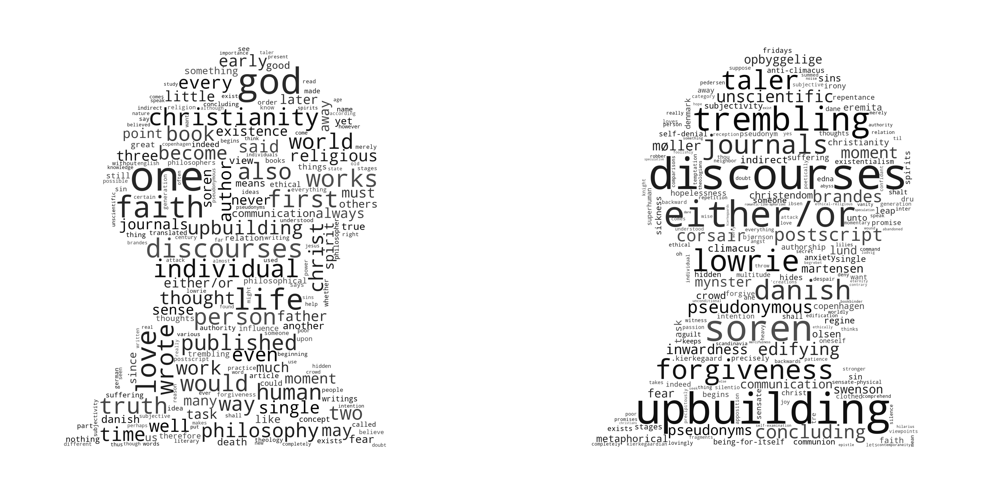

In [293]:
from wordcloud import WordCloud
from PIL import Image
import random

def grey_color_func(word, font_size, position, orientation, random_state=None,
                    **kwargs):
    return "hsl(0, 0%%, %d%%)" % random.randint(0, 30)
fig, axs = plt.subplots(1, 2, figsize=(12,6), dpi=1000)
mask = np.array(Image.open('soren.png'))
for i in range(2):
    if i == 0:
        dictio = TF(phil_data.loc['Søren Kierkegaard']['Content_tokens_clean'])
    else:
        dictio = tf_idf_phil('Søren Kierkegaard')
    wc = WordCloud(mask = mask, background_color='#FFFFFF').generate_from_frequencies(dictio)
    default_colors = wc.to_array()
    axs[i].imshow(wc.recolor(color_func=grey_color_func, random_state=3), interpolation="bilinear")
    axs[i].axis("off")
    #axs.set_title('Søren Kierkegaard')
plt.savefig('kirkegaard_together.png')

On the left we find the TF based WC and on the right we have the TF-IDF based WC. While both graphs are very informative, the are still very different. Right away we find some words which seems to only apply on a danish philosopher such as *danish* and danish names (*møller*) and words such as *opbyggelige* which in english mean *upbuilding* which is also one of the higher rated words. Actually this example is quite interesting as *discourses* and *edifying* which of course is due to the *Eighteen Upbuilding Discourses*, which is one of Kierkegaards more known works. We also find other words such as *unscientific* and *forgiveness* which describes some of Kierkegaards work quite well.

**WordClouds for Core-areas**

Let's see if we can get as nice results for the core-area documents. We follow the same procedure as before:

In [428]:
from wordcloud import WordCloud
from PIL import Image
import random

def grey_color_func(word, font_size, position, orientation, random_state=None,
                    **kwargs):
    return "hsl(0, 0%%, %d%%)" % random.randint(0, 30)
wc = []
for area in tqdm(areas_name):
    #fd = dict(nltk.FreqDist(area_documents_clean[area]))
    dictio = dict(nltk.FreqDist(area_documents[area]))
    #dictio = tf_idf(area)
    wc.append(WordCloud(background_color='#FFFFFF', repeat = False, collocations = False).generate_from_frequencies(dictio))

100%|████████████████████████████████████████████████████████████████████████████████████| 6/6 [00:05<00:00,  1.08it/s]


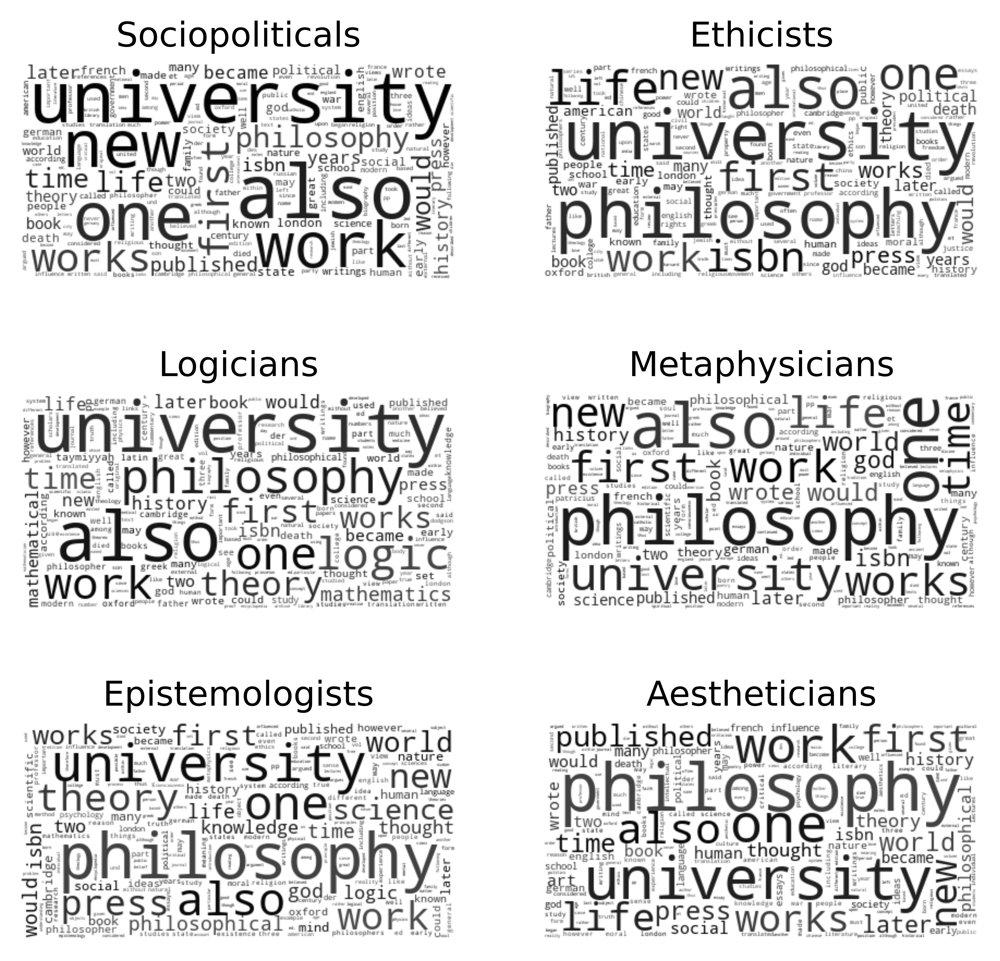

In [429]:
fig, axs = plt.subplots(3, 2, figsize=(6,6), dpi=1000)
pic_number = 0
for i in range(3):
    for k in range(2):
        default_colors = wc[pic_number].to_array()
        axs[i,k].imshow(wc[pic_number].recolor(color_func=grey_color_func), interpolation="bilinear")
        axs[i,k].axis("off")
        axs[i,k].set_title((areas_name[pic_number]).capitalize())
        pic_number += 1 
plt.savefig("WordCloud_tf.png")

In [424]:
wc = []
for area in tqdm(areas_name):
    #fd = dict(nltk.FreqDist(area_documents_clean[area]))
    #dictio = dict(nltk.FreqDist(area_documents_clean[area]))
    dictio = tf_idf(area)
    wc.append(WordCloud(background_color='#FFFFFF', repeat = False, collocations = False).generate_from_frequencies(dictio))

100%|████████████████████████████████████████████████████████████████████████████████████| 6/6 [00:06<00:00,  1.10s/it]


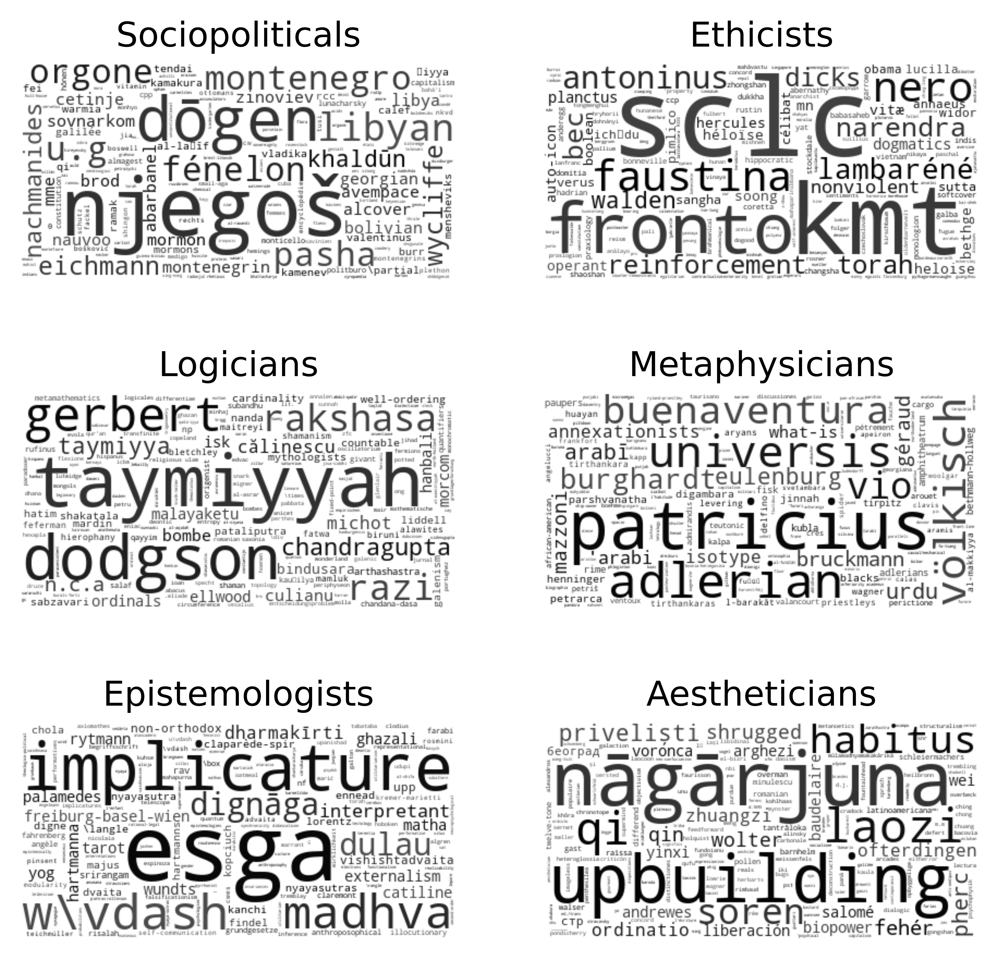

In [425]:
fig, axs = plt.subplots(3, 2, figsize=(6,6), dpi=1000)
pic_number = 0
for i in range(3):
    for k in range(2):
        default_colors = wc[pic_number].to_array()
        axs[i,k].imshow(wc[pic_number].recolor(color_func=grey_color_func), interpolation="bilinear")
        axs[i,k].axis("off")
        axs[i,k].set_title((areas_name[pic_number]).capitalize())
        pic_number += 1 
plt.savefig("WordCloud_tfidf.png")

Unfortunately, these results confirms our observations that we made initally about our TF-IDF results. The TF-IDF WC (last six) are hard to interpret and does not give much information - and it seems like we are better of looking at the most frequent words, although those wordclouds are quite similar. We have tried experimenting with the weighting of the words in the TF-IDF calculations, however without getting bettter results. 

### 3.2.6 Sentiment Analisys

In [29]:
#Remember 
labMT = pd.read_csv('Hedonometer.csv', index_col = 'Rank')
sDict = dict([(token, score) for (token, score) in labMT[["Word", "Happiness Score"]].iloc])

#function
def h_avg(T):
    fd = nltk.FreqDist(T)
    num, den = 0, 0
    for token in T:
        if token in sDict:
            num += fd[token]*sDict[token]
            den += fd[token]
    return num/den

In [30]:
for area in areas_name:
    print(str(area) + ': ' +str(h_avg(area_documents[area])))

sociopoliticals: 5.821139444856648
ethicists: 5.902414341991772
logicians: 5.8218836888386365
metaphysicians: 5.892321721592203
epistemologists: 5.95122996730075
aestheticians: 5.918332223040635


In [31]:
sentiment_analisys = []
for phil in phil_data.index:
    sentiment_analisys += [h_avg(phil_data.Content_tokens_clean[phil])]

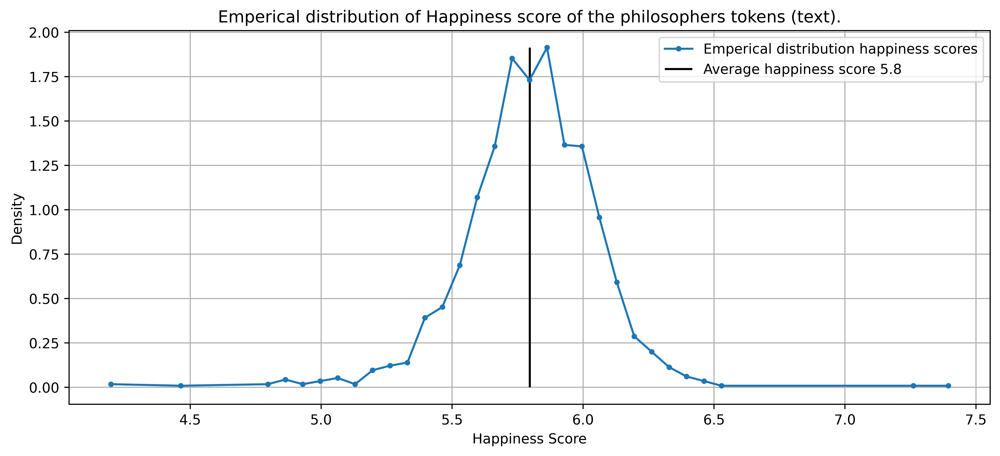

In [32]:
fig, ax = plt.subplots(1, 1, dpi=600, figsize=(12,5))
bins = np.linspace(min(sentiment_analisys), max(sentiment_analisys))
hist, edges_in = np.histogram(sentiment_analisys, bins=bins, density = True)
x = (edges_in[1:]+edges_in[:-1])/2
xx, yy = zip(*[(i,j) for (i,j) in zip(x,hist) if j>0])
ax.plot(xx, yy, marker=".", label = 'Emperical distribution happiness scores')
ax.set_xlabel("Happiness Score")
ax.set_ylabel("Density")
ax.title.set_text("Emperical distribution of Happiness score of the philosophers tokens (text).")
ax.vlines(np.mean(sentiment_analisys),0,max(hist), label = 'Average happiness score ' + str(np.mean(sentiment_analisys).round(2)),color='black')
ax.legend()
ax.grid()
plt.savefig("hapiness_score.png")

Comparing the graph above with the Hedonometer (which describes the happiness scores of twitter from 2009-present) we eyeball that the mean average happiness score of the philosophers' Wikipedia page (app. 5.52) is generally lower that the average happiness score on Twitter (app. 6). This makes sense since Wikipedia is an online encyclopedia, which uses a more objective (and thus neutral) language. Twitter on the other hand, is a hub for subjectivity and social outcry. As seen from the graph above, which is naturally very Guassian due to Central Limit Therem as we look at means. 

### 3.2.7 Lexical Diversity

Lexical diversity is defined by the number of unique word stems divided by the total number of words (called tokens) in the corpus. In as much, the lexical diversity tell us how often a new word-stem is introduced in a corpus. How many words per new letter (on average). In layman terms we can say that repeating the same words many times results in a low lexical diversity. If your corpus is divised of different words only, that means that the cardinality of the set of unique words is equal to the number of total words used, obviously.

Here, it is definitely preferable to use stemmed words as lexical diversity is a measure of unique words, and therefore it is only fair to look at the stem of the words:

In [435]:
stemmer = SnowballStemmer("english")
def stemmer(tokens):
    singles = [SnowballStemmer("english").stem(token) for token in tokens]
    return singles

phil_data['Stemmed_tokes'] = phil_data['Content_tokens_clean'].progress_apply(remove_rubbish)

area_documents_stemmed = {}
for area in areas_name:
    area_documents_stemmed[area] = ([item for sublist in phil_data['Stemmed_tokes'][phil_data['Core_area'] == area] for item in sublist])

100%|██████████████████████████████████████████████████████████████████████████████| 1726/1726 [01:59<00:00, 14.43it/s]


In [437]:
def lexical_diversity(text): 
    return len(set(text)) / len(text)

for area in areas_name:
    print(str(area) + ': ' +str(lexical_diversity(area_documents_stemmed[area])))

sociopoliticals: 0.08857642242767122
ethicists: 0.1417746649318395
logicians: 0.18821956653838362
metaphysicians: 0.17437623034010177
epistemologists: 0.11053924256606315
aestheticians: 0.13377026863836466


We find that the lexical diversity between the different core-areas are actually quite different. 

In [ ]:
#https://stackoverflow.com/questions/50916422/python-typeerror-object-of-type-int64-is-not-json-serializable/50916741
class NpEncoder(json.JSONEncoder):
    def default(self, obj):
        if isinstance(obj, np.integer):
            return int(obj)
        elif isinstance(obj, np.floating):
            return float(obj)
        elif isinstance(obj, np.ndarray):
            return obj.tolist()
        else:
            return super(NpEncoder, self).default(obj)
        
with open('graph.json', 'w') as file:
    json.dump(graph, file, cls=NpEncoder)

## 3.3 Deeper analysis

In [15]:
phil_data['merged_areas'] = None
for phil in phil_data.index:
    if phil_data.loc[phil ,'Core_area'] not in phil_data.loc[phil, 'areas']: 
        phil_data.at[phil, 'merged_areas'] = phil_data.loc[phil, 'areas'] + [phil_data.loc[phil ,'Core_area']]
    else: 
        phil_data.at[phil, 'merged_areas'] = phil_data.loc[phil, 'areas']

In [16]:
G_Undirected = G_Di.to_undirected()

Since we will utilize some methods not well suited for directed graphs, we will now create a undirected graph, wherein if edges in both directions between nodes, $(u,v)$ or $(v,u)$ exist, we make a link between the nodes $u$ and $v$. 

Sanity checking if everything is working according to plan. 

In [17]:
print('Our original undirected network had ' + str(len(G_Di.nodes())) + ' nodes while our new undirected graph has ' + str(len(G_Undirected.nodes())) + ' nodes.')

Our original undirected network had 1645 nodes while our new undirected graph has 1645 nodes.


### 3.3.1 Centrality

An interesting investigation in the undirected network is to compute the Betweenness centrality of nodes. In this particular definition of centrality (and there are many definitions!) nodes that occur in many shortest paths are concidered central in the graph and thus have high centrality scores.

An intuitive way of thinking about betweenness centrality score is to consider the consumer airline network, specifically flight logistics. Imagine you live in Denmark and you are trying to book a flight from Copenhagen to a tiny island off the coast of Africa. How would your flight route look? You probably would not fly directly to the island since such a route (path) does not exist. On the other hand, your itenerary would probably not involve having you fly to Russia or the USA for a layover either. The most efficient route (i.e. the shortest path) would probably include a layover in a popular airport in Europe, like Amsterdam, and/or a layover in an airport closer to your final destination, like Dubai. Big airports enable many possible flight routes, i.e. shortest paths, and are by definition very central to the aerospace network and thus have high betweenness centrality.

For our philosopher network, the centrality betweenness becomes slightly more abstract, as links are now not flight routes but rather hyperlinks between wikipedia pages.

In [18]:
directed_betweenness = dict(nx.betweenness_centrality(G_Di))

In [19]:
import collections
collections.Counter(directed_betweenness).most_common()[:10]

[('Immanuel Kant', 0.044104190780499444),
 ('Aristotle', 0.04346929373974577),
 ('Plato', 0.03738700942404071),
 ('Georg Wilhelm Friedrich Hegel', 0.028274442694618967),
 ('Bertrand Russell', 0.023938104495278497),
 ('Friedrich Nietzsche', 0.022595070095741184),
 ('René Descartes', 0.02109090757130415),
 ('David Hume', 0.02095103704189233),
 ('Maimonides', 0.02009951288921042),
 ('Karl Marx', 0.019600094757050844)]

### 3.3.2 Assortativity
Even though the course has not gone through the concept of assortativity, we will find in intersting as it tells us something about how nodes link to other nodes. We will investigate the degree assortativity and the atrribut assortativity and see which is higher. The most important part, as always, it to also evaluate if the results deviate significantly from what we would expect from a randomly linke network. 

In [20]:
nx.degree_assortativity_coefficient(G_Di.to_undirected(), x='out', y='in', weight=None, nodes=None)

0.034686447640754035

In [21]:
nx.attribute_assortativity_coefficient(G_Di.to_undirected(),'areas')

0.09862169166333991

As seen, the attribute assortativity is higher than the degree assortativity, which implies that nodes tend to link to other nodes with the same attribute (core-area) than to nodes of the same degree. We will investigate this further below. Since the double swap algorithm only works for undirected graphs, we will simply calculate this for the undirected graph. 

### 3.3.3 Modularity  and assortativity

To determine if the modularity of our split is significant or not, we will first compute the modularity, and then the best split using the Louvain algorithm, and then use the double-swap algorithm to see if our partition yields in a significant modularity score. 

In [22]:
def Mc(graph, att, com):
    com_nodes = [n for n in graph.nodes if graph.nodes[n][att] == com]
    Lc = graph.subgraph([n for n in com_nodes]).number_of_edges()
    L = graph.number_of_edges()
    kc = sum([graph.degree[n] for n in com_nodes])
    return (Lc/L) - ((kc/(2*L))**2)

In [23]:
def M(graph, att):
    communities = set([graph.nodes[n][att] for n in graph.nodes])
    return sum([Mc(graph, att, com) for com in communities])

The current modularity of our partition is: 

In [24]:
M(G_Di.to_undirected(),'areas')

0.07451572737310683

While the best split, found using the Louvain algorithm, has a modularity score of.

In [25]:
import community as community_louvain
import matplotlib.cm as cm
G_best_partition = G_Di.to_undirected().copy()
partition = community_louvain.best_partition(G_best_partition)


In [26]:
cmap = cm.get_cmap('viridis', max(partition.values()) + 1)
for n in G_best_partition.to_undirected().nodes:
    color = cmap.colors[partition[n]][:3]
    G_best_partition.nodes[n]['color'] = "#" + "".join(["%0.2X" % int(c*255) for c in color])

In [ ]:
network, config = visualize(G_Di.to_undirected(), verbose=False, config=config_G_area);

In [ ]:
network, config = visualize(G_best_partition, verbose=False, config=config_G_area);

In [27]:
M(G_best_partition, 'color')

0.38846437971419984

As seen, the modularity computed from the best partition (using the Louvain algorithm) is much higher, but still far from 1. We cannot however say, that just because we have a low modularity score for our core-area partition, that our partition is bad. We therefore create 100 random versions of our Philosophy network using the double-swap algorithm to see if the computed modularity score is significant. We do the same for the assortativity scores. 

In [28]:
iterations = 100

modularity = np.empty(iterations)
degree_assortativity = np.empty(iterations)
attribute_assortivity = np.empty(iterations)

for i in tqdm(range(iterations)):
    Gnew = G_Di.to_undirected().copy()
    Gnew = nx.algorithms.swap.double_edge_swap(Gnew, nswap=len(Gnew.edges),  max_tries=len(Gnew.edges)**2)
   
    modularity[i] = M(Gnew, 'areas')
    degree_assortativity[i] = nx.degree_assortativity_coefficient(Gnew, x='out', y='in', weight=None, nodes=None)
    attribute_assortivity[i] = nx.attribute_assortativity_coefficient(Gnew,'areas')

100%|████████████████████████████████████████████████████████████████████████████| 100/100 [02:35<00:00,  1.56s/it]


In [29]:
print("The mean modularity of the configuration models is {:.4f} ± {:.4f}".format(np.mean(modularity), np.std(modularity)))

The mean modularity of the configuration models is 0.0030 ± 0.0015


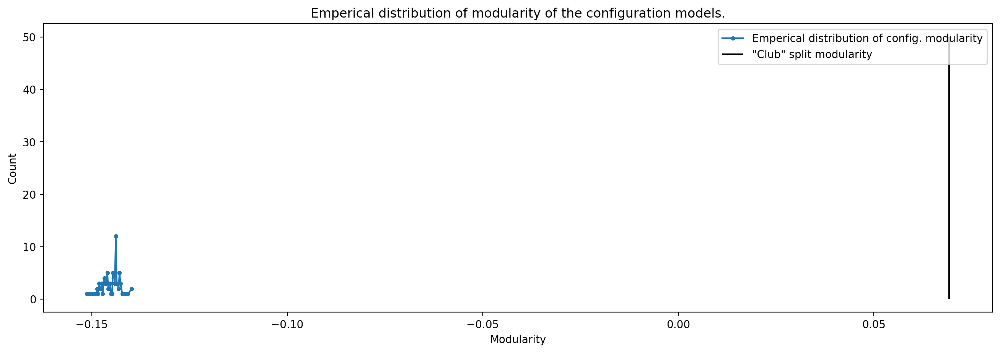

In [97]:
fig, ax = plt.subplots(1, 1, dpi=200, figsize=(16,5))
bins = np.linspace(min(degree_assortativity), max(degree_assortativity))
hist, edges_in = np.histogram(degree_assortativity, bins=bins)
x = (edges_in[1:]+edges_in[:-1])/2
xx, yy = zip(*[(i,j) for (i,j) in zip(x,hist) if j>0])
ax.plot(xx, yy, marker=".", label = 'Emperical distribution of config. modularity')
ax.vlines(nx.degree_assortativity_coefficient(G_Di, x='out', y='in', weight=None, nodes=None),0,50, label = '"Club" split modularity',color='black')
ax.set_xlabel("Modularity")
ax.set_ylabel("Count")
ax.title.set_text("Emperical distribution of modularity of the configuration models.")
ax.legend()

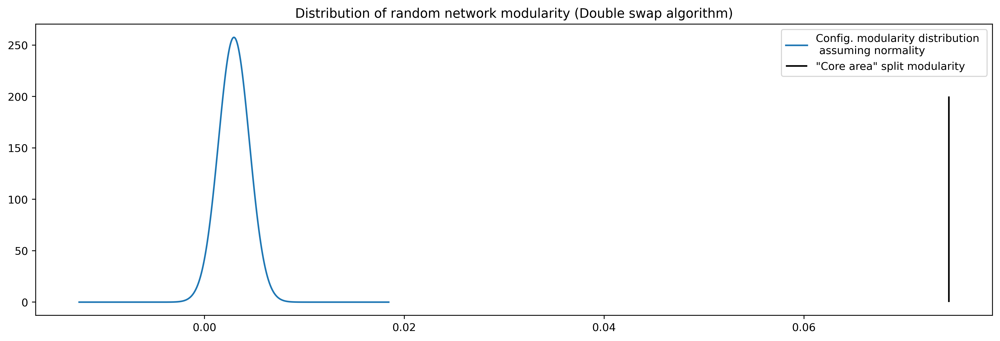

In [30]:
import math
from scipy import stats

mu = np.mean(modularity)
variance =  np.var(modularity)
sigma = math.sqrt(variance)
x = np.linspace(mu - 10*sigma, mu + 10*sigma, 1000)

fig, ax = plt.subplots(1, 1, dpi=400, figsize=(16,5))
ax.plot(x, stats.norm.pdf(x, mu, sigma), label = 'Config. modularity distribution \n assuming normality')
ax.vlines(M(G_Di.to_undirected(),'areas'),0,200, label = '"Core area" split modularity',color='black')
plt.title(label = 'Distribution of random network modularity (Double swap algorithm)')
ax.legend();
plt.savefig('Modularity', dpi = 1000)

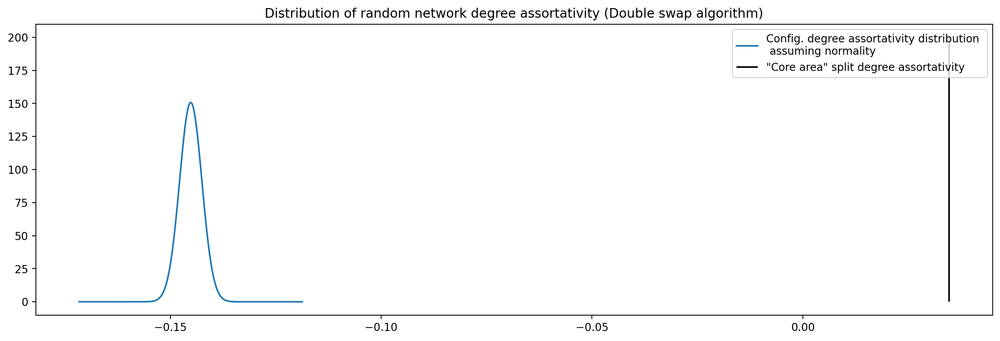

In [31]:
mu = np.mean(degree_assortativity)
variance =  np.var(degree_assortativity)
sigma = math.sqrt(variance)
x = np.linspace(mu - 10*sigma, mu + 10*sigma, 1000)

fig, ax = plt.subplots(1, 1, dpi=200, figsize=(16,5))
ax.plot(x, stats.norm.pdf(x, mu, sigma), label = 'Config. degree assortativity distribution \n assuming normality')
ax.vlines(nx.degree_assortativity_coefficient(G_Di.to_undirected(), x='out', y='in', weight=None, nodes=None),0,200, label = '"Core area" split degree assortativity',color='black')
plt.title(label = 'Distribution of random network degree assortativity (Double swap algorithm)')
ax.legend();
plt.savefig('degree_assortivity', dpi = 1000)

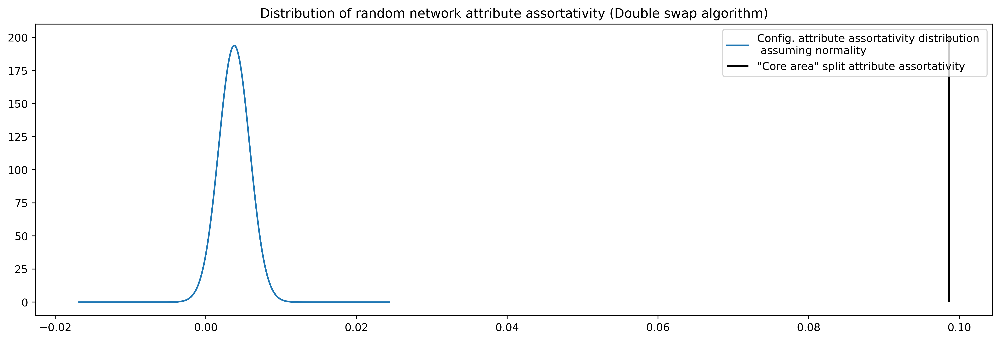

In [32]:
mu = np.mean(attribute_assortivity)
variance =  np.var(attribute_assortivity)
sigma = math.sqrt(variance)
x = np.linspace(mu - 10*sigma, mu + 10*sigma, 1000)

fig, ax = plt.subplots(1, 1, dpi=400, figsize=(16,5))
ax.plot(x, stats.norm.pdf(x, mu, sigma), label = 'Config. attribute assortativity distribution \n assuming normality')
ax.vlines(nx.attribute_assortativity_coefficient(G_Di.to_undirected(),'areas'),0,200, label = '"Core area" split attribute assortativity',color='black')
plt.title(label = 'Distribution of random network attribute assortativity (Double swap algorithm)')
ax.legend();
plt.savefig('attribute_assortivity', dpi = 1000)

As seen from all 3 plots above, our computed modularity, degree assortativity and attribute are all significantly different from what we would expect from the random networks generated. This means that our parition is a fairly good split, that the degree assortativity and the attribute assortativity is somewhat assortative, and that our network (the undirected version) is more assortative wrt. attribute than wrt. degree (although degree is more significant). 

### 3.3.4 Branch Communities


In [73]:
# first we make the subgraphs for each core area
G_Di_sociopoliticals = G_Di.subgraph([philosopher for philosopher in phil_data.index if 'sociopoliticals' in phil_data.loc[philosopher]['merged_areas']])
G_Di_metaphysicians = G_Di.subgraph([philosopher for philosopher in phil_data.index if 'metaphysicians' in phil_data.loc[philosopher]['merged_areas']])
G_Di_logicians = G_Di.subgraph([philosopher for philosopher in phil_data.index if 'logicians' in phil_data.loc[philosopher]['merged_areas']])
G_Di_epistemologists = G_Di.subgraph([philosopher for philosopher in phil_data.index if 'epistemologists' in phil_data.loc[philosopher]['merged_areas']])
G_Di_aestheticians = G_Di.subgraph([philosopher for philosopher in phil_data.index if 'aestheticians' in phil_data.loc[philosopher]['merged_areas']])
G_Di_ethicists = G_Di.subgraph([philosopher for philosopher in phil_data.index if 'ethicists' in phil_data.loc[philosopher]['merged_areas']])
G_Di_none = G_Di.subgraph([phil for phil in phil_data.index[phil_data['Core_area']==None]])

Furhtermore, we wish to explore some key statistics for the branch-subgraphs.

In [74]:
branch_name = ['sociopoliticals','metaphysicians','logicians','epistemologists','aestheticians','ethicists']

In [75]:
branches = [G_Di_sociopoliticals,G_Di_metaphysicians,G_Di_logicians,G_Di_epistemologists,G_Di_aestheticians,G_Di_ethicists]

In [182]:
total_views = 0

for phil in G_Di.nodes():
    if phil == 'Hierocles (Stoic)':
        total_views += 0
    else:
        total_views += int(G_Di.nodes()[phil]['view_count'])

We compute the branch size, branch density, branch clustering and the branch view proportion of total views using the following code:

In [194]:
branch_size = []
branch_density = []
branch_clustering = []
branch_relative_size = []
branch_views_relative_views = []
for branch in tqdm(branches):
    branch_size += [len(branch)]
    branch_density += [nx.density(branch)]
    branch_clustering += [nx.average_clustering(branch)]
    branch_relative_size += [len(branch)/total_nodes]
    
    view = 0
    for phil in branch.nodes():
        if phil == 'Hierocles (Stoic)':
            view += "02467_ Social Informatik.pdf"
        else:
            view += int(branch.nodes()[phil]['view_count'])
    branch_views_relative_views += [view/total_views]
    

100%|████████████████████████████████████████████████████████████████████████████████| 6/6 [00:20<00:00,  3.44s/it]


And then get the branch of philosophy lists from wikipedia, since we want to compute the proportional change after implementing our core-area algorithm in each branch. 

In [37]:
aestheticians = wikipedia.page("List_of_aestheticians").links
epistemologists = wikipedia.page("List_of_epistemologists").links
ethicists = wikipedia.page("List_of_ethicists").links
logicians = wikipedia.page("List_of_logicians").links
metaphysicians = wikipedia.page("List_of_metaphysicians").links
sociopoliticals = wikipedia.page("index_of_sociopolitical_thinkers").links

The original branch size is just the length of each list downloaded. 

In [38]:
branch_original_size = [len(sociopoliticals),len(metaphysicians),len(logicians),len(epistemologists),len(aestheticians),len(ethicists)]

And the proportion is computed for both the original data, and the partitioned data: 

In [39]:
branch_original_proportion = []

for branch in branch_original_size:
    branch_original_proportion += [branch/sum(branch_original_size)]

In [40]:
branch_partition_proportion = []

for branch in branch_size:
    branch_partition_proportion += [branch/sum(branch_size)]

We then wish to compute the relative change in proportion after running our core-area algorithm. We call this Bias, since it is a measure of bias under the assumption that in a correct core-area classification, the respective classes proportionality should remain unchanged (whether this is a fair assumption remains to be discussed). Values close to 1 indicate no proportional change. If the bias values are lower or higher, this means that they have seen an respective decrease or increase in proportion. 

In [41]:
branch_bias = []

for branch in range(len(branches)):
    branch_bias += [branch_partition_proportion[branch]/branch_original_proportion[branch]]

Finally we wish to give a number, based on the core-area, of the purity of the subgraphs. For each branch we create a subgraph. The purity is simply the proportion of philosophers with core-area equal to the branch. 

In [42]:
branch_purity = []

for branch in range(len(branches)):
    branch_purity += [list(dict(branches[branch].nodes('areas')).values()).count(branch_name[branch])/len(branches[branch])]

In [197]:
branch_communities = pd.DataFrame( index = branch_name) 
branch_communities = branch_communities.assign(Size = branch_size, Density = branch_density, Clustering = branch_clustering, Purity = branch_purity,Bias = branch_bias,Relative_size = branch_relative_size, Relative_Views = branch_views_relative_views)

In [198]:
branch_communities.round(3)

,Size,Density,Clustering,Purity,Bias,Relative_size,Relative_Views
sociopoliticals,998,0.032,0.488,0.873,1.465,0.607,0.700
metaphysicians,395,0.105,0.588,0.263,1.160,0.240,0.323
logicians,252,0.097,0.546,0.401,0.555,0.153,0.215
epistemologists,313,0.153,0.635,0.744,1.353,0.190,0.290
aestheticians,169,0.141,0.610,0.929,0.896,0.103,0.169
ethicists,312,0.112,0.594,0.497,0.574,0.190,0.378


As seen from the dataframe above, the sociopolitical graph is the largest and also has the lowest density, which is not suprising since we expect lower density in larger networks. It does however have the highest Bias which leads us to believe that many . However, the smallest network, the aestheticians does not only have the highest purity, but also the least relative change (bias). Apparently the aestheticians are a small but pure network, and thus it is harder to become a part of. The clustering is the second highest for the aesteticians. Moreover, we see than the relative_views are much larger in all categories than the relative size. This is simply because we have high_view philosophers in multiple branches, which skew the relative views. 

### 3.3.5 Temporal fun (might or might not be included in website - thanks for making it here Laura)
We now wish to create a temporal graph, such that philosophers can only inspire younger people than themselves. First we give all nodes a year attribute. 

In [45]:
for node in G_Di.nodes():
    G_Di.nodes[node]["year"] = phil_data.loc[node]['Year']

Then we make a copy of the directed graph to modify. 

In [46]:
G_temporal = G_Di.copy()

For each node in the directed graph we then check if the soucenode is older than the target node. If it is, we remove it under the assumption that you cannot inflience someone who is older than yourself. 

In [47]:
for (source,target) in G_Di.edges():
    if G_Di.nodes[source]["year"] >= G_Di.nodes[target]["year"]:
        G_temporal.remove_edge(source,target)

If we have done the above correctly, the graph is now a directed acyclic graph. 

In [48]:
nx.is_directed_acyclic_graph(G_temporal)

True

And it is, viola! 

In [53]:
M(G_temporal.to_undirected(),'areas')

0.0746251856706915

We can then look at all ancestors of a node. Remember ancestors are nodes that could possibly have influence the philosopher in question (and possible path to the node in question). As a sanity check we check aristotle. 

In [54]:
nx.ancestors(G_temporal,'Plato')

{'Anaxagoras',
 'Anaximander',
 'Anaximenes of Miletus',
 'Antiphon (person)',
 'Archytas',
 'Aristippus',
 'Confucius',
 'Democritus',
 'Diogenes of Apollonia',
 'Empedocles',
 'Epicharmus',
 'Gautama Buddha',
 'Gorgias',
 'Guan Zhong',
 'Heraclitus',
 'Hesiod',
 'Hippocrates',
 'Homer',
 'Isocrates',
 'Mahavira',
 'Mozi',
 'Philolaus',
 'Prodicus',
 'Protagoras',
 'Pythagoras',
 'Socrates',
 'Sun Tzu',
 'Thales',
 'Theodorus of Cyrene',
 'Thucydides',
 'Xenophanes',
 'Yajnavalkya',
 'Zeno of Elea'}

As seen, all of the ancestors of Plato are ancient philosophers, and primarily greek. We have a single philosopher Guan Zhon, who is not greek, but it is not impossible that he has influenced Plato's ideas in a minute way. 

### Sociopoliticals

In [259]:
network, _ = visualize(G_Di_sociopoliticals, verbose=False);

In [264]:
import collections
directed_betweenness_sociopliticals = dict(nx.betweenness_centrality(G_Di_sociopoliticals))
collections.Counter(directed_betweenness_sociopliticals).most_common()[:20]

In [277]:
for i in top_20:
    print(np.round(i[1],3))

0.051
0.036
0.029
0.027
0.024
0.024
0.023
0.023
0.02
0.018
0.016
0.015
0.015
0.013
0.013
0.013
0.013
0.013
0.012
0.012


### Metphysicians

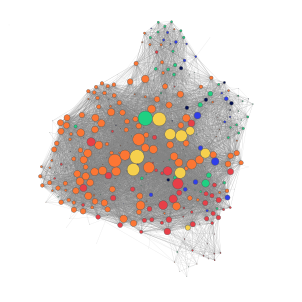

In [253]:
network, _ = visualize(G_Di_metaphysicians, verbose=False);

In [279]:
directed_betweenness_metaphysicians = dict(nx.betweenness_centrality(G_Di_metaphysicians))
collections.Counter(directed_betweenness_metaphysicians).most_common()[:20]

### Logicians

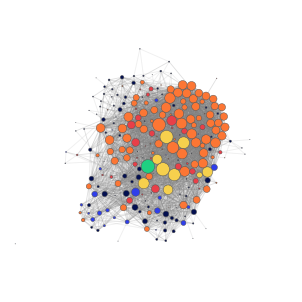

In [255]:
network, _ = visualize(G_Di_logicians, verbose=False);

In [115]:
directed_betweenness_logicians = dict(nx.betweenness_centrality(G_Di_logicians))
collections.Counter(directed_betweenness_logicians).most_common()[:20]

[('Aristotle', 0.0697264512059047),
 ('Plato', 0.06555253132792362),
 ('Bertrand Russell', 0.059694138698944424),
 ('Immanuel Kant', 0.05372344346583512),
 ('Charles Sanders Peirce', 0.04055877420332519),
 ('Kurt Gödel', 0.03364396100571781),
 ('Averroes', 0.028765261314574908),
 ('Augustine of Hippo', 0.025638463150205976),
 ('David Hume', 0.025046177377601297),
 ('Georg Wilhelm Friedrich Hegel', 0.02231790659480713),
 ('Saul Kripke', 0.021953905983945733),
 ('René Descartes', 0.0213743743715285),
 ('Ludwig Wittgenstein', 0.02099889068539652),
 ('John Stuart Mill', 0.018937999269814862),
 ('Gottlob Frege', 0.018681881989505596),
 ('Thomas Aquinas', 0.0179035749130022),
 ('Karl Popper', 0.017549952206926196),
 ('Alfred Tarski', 0.017386385316782216),
 ('Edmund Husserl', 0.016442977817508753),
 ('Avicenna', 0.016166069608665866)]

### Epistemologists

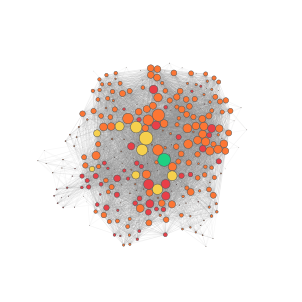

In [256]:
network, _ = visualize(G_Di_epistemologists, verbose=False);

In [116]:
directed_betweenness_epistemologists = dict(nx.betweenness_centrality(G_Di_epistemologists))
collections.Counter(directed_betweenness_epistemologists).most_common()[:20]

[('Immanuel Kant', 0.06859738931509585),
 ('Plato', 0.04049592546168733),
 ('David Hume', 0.02774928894254269),
 ('Bertrand Russell', 0.026222635057353685),
 ('Georg Wilhelm Friedrich Hegel', 0.02336266903735193),
 ('Karl Popper', 0.023291122230883334),
 ('Baruch Spinoza', 0.023156511544466744),
 ('René Descartes', 0.019934753179818753),
 ('Aristotle', 0.018202658306515098),
 ('Augustine of Hippo', 0.017308129804693956),
 ('Friedrich Nietzsche', 0.01640246581755444),
 ('Ludwig Wittgenstein', 0.01573454090512222),
 ('Noam Chomsky', 0.01552511304007615),
 ('Arthur Schopenhauer', 0.01479709987085339),
 ('Confucius', 0.014512678028863104),
 ('Søren Kierkegaard', 0.012885684266884634),
 ('Zhu Xi', 0.012561008272683425),
 ('John Locke', 0.012426572492946224),
 ('John Stuart Mill', 0.01206984067430663),
 ('Edward N. Zalta', 0.01105877478898244)]

### Aestheticians

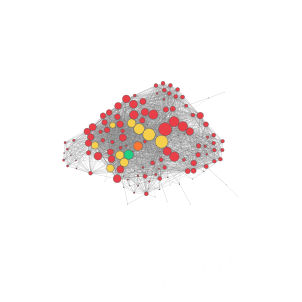

In [257]:
network, _ = visualize(G_Di_aestheticians, verbose=False);

In [117]:
directed_betweenness_aestheticians = dict(nx.betweenness_centrality(G_Di_aestheticians))
collections.Counter(directed_betweenness_aestheticians).most_common()[:20]

[('Georg Wilhelm Friedrich Hegel', 0.0742700507460096),
 ('Immanuel Kant', 0.0681258742767373),
 ('Friedrich Nietzsche', 0.061157253232868754),
 ('Plato', 0.03558609572921255),
 ('Martin Heidegger', 0.03492695670491893),
 ('David Hume', 0.03196395680938638),
 ('Bertrand Russell', 0.029832191187763805),
 ('Søren Kierkegaard', 0.027291304651969453),
 ('Arthur Schopenhauer', 0.024562698556450845),
 ('Ralph Waldo Emerson', 0.02285118061508848),
 ('Augustine of Hippo', 0.022457823511711234),
 ('Aristotle', 0.020330870558506967),
 ('Roman Ingarden', 0.01836497448238725),
 ('Confucius', 0.016951404868400455),
 ('Georg Lukács', 0.015238069576131797),
 ('Thomas Reid', 0.01362862889971742),
 ('Mencius', 0.013514278961742504),
 ('Daniel Dennett', 0.013477541073481316),
 ('José Ortega y Gasset', 0.012797622350633989),
 ('Friedrich Schleiermacher', 0.012415056923795659)]

### Ethicists

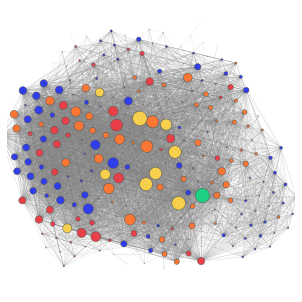

In [258]:
network, _ = visualize(G_Di_ethicists, verbose=False);

In [118]:
directed_betweenness_ethicists = dict(nx.betweenness_centrality(G_Di_ethicists))
collections.Counter(directed_betweenness_ethicists).most_common()[:20]

[('Plato', 0.0596325049726858),
 ('Immanuel Kant', 0.05875004038298541),
 ('Aristotle', 0.04090020056590806),
 ('David Hume', 0.03568415532857373),
 ('Bertrand Russell', 0.031086931558588493),
 ('Maimonides', 0.022065063042901366),
 ('Friedrich Nietzsche', 0.02155596561006202),
 ('Georg Wilhelm Friedrich Hegel', 0.02124145654889686),
 ('Augustine of Hippo', 0.02080555031680589),
 ('Cicero', 0.020020842343074063),
 ('John Rawls', 0.01929161980797013),
 ('Edmund Husserl', 0.018729019070962534),
 ('Socrates', 0.017065506554698545),
 ('Søren Kierkegaard', 0.01658149875204309),
 ('Jürgen Habermas', 0.015700669726013073),
 ('Baruch Spinoza', 0.013984328621968703),
 ('John Stuart Mill', 0.01375787418343421),
 ('Arthur Schopenhauer', 0.0134191607922748),
 ('Jeremy Bentham', 0.013317746727693272),
 ('Confucius', 0.013021491793649023)]

# 4 Discussion

## 4.1 What went well?
The overall netywork analysis was very interesting and thus pushed us to go further beyond course curriculum and explore networking tools previously unknown to us. The community detection worked fairily well considering the simplicity of the algorithm implemented. The interactive parts of the website turned out as imagined, and is definitely somethin we will turn back to look at. 

While the network part of the assignment was our main focus, some of the elements in the text analysis showed some usable results, especially when examining specific philosophers, although for communities our text analysis had some shortcommings. 

## 4.2 What is still missing?
As we mentioned in our pitch of the project, we had hoped to compare our network with a similar network created using the Standford Encyclopedia of Philosophy. However, as with most projects we underestimated how timeconsuming one graph was in itself. 

As mentioned above, a second shortcomming of the project were the WordClouds created for the branches of philosophy. It can be hard to say what caused these issues, however it could be that the content of the documents simply was too similar, or that the assumptions/algorithm made when infering the core-area didn't assign the right area for each philosopher, making it hard to find any sense in the document. Another shortcomming regard the text analysis was the sentiment analysis which turned our to be as uninteresting as expected.

Other investigations we had hoped to have time for, was more exotic ways of inferring core-areas for philosophers. In our opinion, there are two interesting ways of going about this. First and foremost, one could have looked at all outgoing links, and compared those to the philosophers which we already had certain core areas for. Another more computationally heavy method could have been to create word embedding vectors for the branches of philosophy (the Wikipedia lists) and categorized using similarity scores.

## 4.3 What could be improved and why?
As we continued further into to our network analysis we kept finding more interesting stuff to create and use for our analysis - only time was a limiting factor. 

While we tried to balance the TF-IDF measure to give us something meaningful, we failed to accomplish that for the core areas. If time had allowed it, we would have experimented with this some more. 